In [2]:
import pandas as pd
import numpy as np
from datetime import datetime
from datetime import date
import time
from time import mktime
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import patsy
from patsy import dmatrices
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LogisticRegression, LinearRegression
import statsmodels.api as sm
import folium
from pandas import *
from folium.map import Icon, Marker, Popup
import pickle

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [143]:
NY_merged_samp = pd.read_pickle('../../datasets/NY_merged_samp.pkl')
NY_merged_samp = NY_merged_samp[NY_merged_samp['DATE'] < '01/01/2016']

In [4]:
## The Transportation Division of the New York City Department of City Planning (NYCDCP) has performed annual 
## bike counts in Manhattan since 1999. The counts have been conducted along designated bicycle routes at 10 
## on-street and 5 off-street locations during the fall season. These locations have remained generally consistent. 
## The data collected includes cyclist/user volumes, helmet usage, use of bike lane, gender, etc. The bike counts 
## data can offer insights into the overall trends in user demographics and travel patterns over time.

bike_count = pd.read_csv('../../../Desktop/datasets/NYC_bike_count.csv', parse_dates=True)
bike_count.dropna(inplace=True)

## i only want to show the data for which I'm concerned
bike_count = bike_count[bike_count['Year']>=2012]

In [5]:
## creating a function that separates my data into different segments for time series analysis

def segment_func(bike_df, start_date, end_date):
    segment_mask = (bike_df['DATE'] >= start_date) & (bike_df['DATE'] <= end_date)
    bike_segment = bike_df[segment_mask]
    return bike_segment

## creating a borough column to create another feature for my model

def borough(col):
    borough_cat = []
    for i in col:
        if i == 'BROOKLYN':
            borough_cat.append(1)
        elif i == 'MANHATTAN':
            borough_cat.append(2)
        elif i == 'QUEENS':
            borough_cat.append(3)
        elif i == 'BRONX':
            borough_cat.append(4)
        elif i == 'STATEN ISLAND':
            borough_cat.append(5)
        else:
            borough_cat.append(0)
    return borough_cat

## assigning a month column to create another feature for my model

def month_extract(col):
    MONTH = []
    for i in col:
        MONTH.append(i.month)
    return MONTH

def month_name(col):
    month_name = []
    for i in col:
        if i == 1:
            month_name.append('Jan')
        elif i == 2:
            month_name.append('Feb')
        elif i == 3:
            month_name.append('Mar')
        elif i == 4:
            month_name.append('Apr')
        elif i == 5:
            month_name.append('May')
        elif i == 6:
            month_name.append('Jun')
        elif i == 7:
            month_name.append('Jul')
        elif i == 8:
            month_name.append('Aug')
        elif i == 9:
            month_name.append('Sep')
        elif i == 10:
            month_name.append('Oct')
        elif i == 11:
            month_name.append('Nov')
        elif i == 12:
            month_name.append('Dec')
        else:
            month_name.append('NA')
    return month_name

## writing a function to extract the hour of the day from the datetime objects ('DATE' column) so that I can plot each 
## segment's volume of injury/death per each hour and see what time of day is most dangerous.

def hour_extract(col):
    HOUR = []
    for i in col:
        HOUR.append(i.hour)
    return HOUR

## extracting the year from the date column
def year(col):
    year = []
    for i in col:
        year.append(i.year)
    return year

## making a function that will convert the Army time hour to a standard hour of the day (example: 20 --> 8pm)

def time_segment(col):
    time_segment = []
    for i in col:
        if (i >= 0) & (i <= 6):
            time_segment.append('early_morning')
        elif (i > 6) & (i <= 12):
            time_segment.append('mid-morning')
        elif (i > 12) & (i <= 15):
            time_segment.append('afternoon')
        elif (i > 15) & (i <= 19):
            time_segment.append('evening')
        elif (i > 19) & (i<=24):
            time_segment.append('late-night')
        else:
            time_segment.append('NA')
    return time_segment
        
## making a function that creates a list containing a '1' if there was a cyclist injured/killed and a '0' if there were
## no cyclists injured/killed

def binary(col):
    CYCLISTS_INJURED = []
    for i in col:
        if i > 0:
            CYCLISTS_INJURED.append(1)
        else:
            CYCLISTS_INJURED.append(0)
    return CYCLISTS_INJURED

def weather(col):
    rain = []
    for i in col:
        if i > 0:
            rain.append(1)
        else:
            rain.append(0)
    return rain

## building a function that separates the amount of precipitation in NYC into 6 varying buckets of intensity (0:5)

def precip(col):
    precip_cat = []
    for i in col:
        if (i > 0) & (i <= 1.00):
            precip_cat.append(1)
        elif (i > 1.00) & (i <= 2.00):
            precip_cat.append(2)
        elif (i > 2.00) & (i <= 3.00):
            precip_cat.append(3)
        elif (i > 3.00) & (i <= 4.00):
            precip_cat.append(4)
        elif (i > 4.00) & (i <= 5.00):
            precip_cat.append(5)
        else:
            precip_cat.append(0)
    return precip_cat


## building a function that separates the mean temperature/dewpoints of each day in NYC into 20+ buckets between 
## the range 0 and 100

def temp(col):
    temp_cat = []
    for i in col:
        if (i > -20) & (i <= 0):
            temp_cat.append(1)
        elif (i > 0) & (i <= 20):
            temp_cat.append(2)
        elif (i > 20) & (i <= 40):
            temp_cat.append(3)
        elif (i > 40) & (i <= 60):
            temp_cat.append(4)
        elif (i > 60) & (i <= 80):
            temp_cat.append(5)
        elif (i > 80) & (i <= 100):
            temp_cat.append(6)   
        else:
            temp_cat.append('NA')
    return temp_cat
            
            
def wind(col):
    wind_cat = []
    for i in col:
        if (i >= 0) & (i <= 5):
            wind_cat.append(1)
        elif (i > 5) & (i <= 10):
            wind_cat.append(2)
        elif (i > 10) & (i <= 15):
            wind_cat.append(3)
        else:
            wind_cat.append(4)
    return wind_cat

def pop(col):
    NEW_TIME = []
    for i in col:
        NEW_TIME.append(i[:-3])
    return NEW_TIME

def weekday(col):
    day_of_week = []
    for i in col:
        day_of_week.append(i.weekday())
    return day_of_week

## creating a function that adds a column 'season' to the dataframe

def season(col):
    season = []
    for i in col:
        if (i >='03/20/2013') & (i <= '06/21/2013'):
            season.append('Spring')
        elif (i > '06/21/2013') & (i <= '09/22/2013'):
            season.append('Summer')
        elif (i > '09/22/2013') & (i <= '12/21/2013'):
            season.append('Fall')
        else:
            season.append('Winter')
    return season

In [144]:
## renaming the columns in the sample merged dataset

NY_merged_samp.rename(columns={'NUMBER_OF_CYCLIST_INJURED':'injuries',
                               'NUMBER_OF_CYCLIST_KILLED':'deaths',
                              'CONTRIBUTING_FACTOR_VEHICLE_1':'vehicle_1',
                               'Max_TemperatureF':'max_temp',
                               'Mean_TemperatureF':'mean_temp',
                               'Min_TemperatureF':'min_temp',
                               'Max_Dew_PointF':'max_dew',
                               'MeanDew_PointF':'mean_dew',
                               'Min_DewpointF':'min_dew',
                               'Max_Humidity':'max_humid',
                               '_Mean_Humidity':'mean_humid',
                               '_Min_Humidity':'min_humid',
                               '_Max_VisibilityMiles':'max_visible',
                               '_Mean_VisibilityMiles':'mean_visible', 
                               '_Min_VisibilityMiles':'min_visible',
                               '_Max_Wind_SpeedMPH':'max_wind',
                               '_Mean_Wind_SpeedMPH':'mean_wind',
                               '_Max_Gust_SpeedMPH':'max_gust',
                               'PrecipitationIn':'precip', 
                               '_CloudCover':'clouds'
                              },inplace=True)


NY_merged_samp.precip.replace('T', '0', inplace=True)
NY_merged_samp.precip = NY_merged_samp.precip.astype(float)

In [145]:
## passing columns through my functions to create the features to include in my model

NY_merged_samp['borough_cat'] = borough(NY_merged_samp['BOROUGH'])
NY_merged_samp['precip_scale'] = precip(NY_merged_samp['precip'])
NY_merged_samp['month'] = month_extract(NY_merged_samp['DATE'])
NY_merged_samp['injuries_binary'] = binary(NY_merged_samp['injuries'])
NY_merged_samp['temp_cat'] = temp(NY_merged_samp['mean_temp'])
NY_merged_samp['dew_cat'] = temp(NY_merged_samp['mean_dew'])
NY_merged_samp['humid_cat'] = temp(NY_merged_samp['mean_humid'])
NY_merged_samp['time_segment'] = time_segment(NY_merged_samp['TIME'])
NY_merged_samp['day_of_week'] = weekday(NY_merged_samp['DATE'])
NY_merged_samp['year'] = year(NY_merged_samp['DATE'])
NY_merged_samp['month_name'] = month_name(NY_merged_samp['month'])
NY_merged_samp['precip'].replace(to_replace='T', value=0.00, inplace=True)
NY_merged_samp['precip'] = NY_merged_samp['precip'].astype(float)


In [8]:
## creating two columns: one that is the total number of cyclists that were not wearing a helment and the other is the 
## ratio of cyclists not wearing a helmet. I want to plot these against eachother to show the trend/relationship 
## between the two variables

bike_count['No_helmet'] = (bike_count['CyclistVolume'] - bike_count['Cycl_Helmet_all'])
bike_count['No_helmet_ratio'] = (bike_count['Cycl_Helmet_all'] / bike_count['CyclistVolume'])
bike_count.head()

,LocationID,LocationType,TypeOfTime,Location,Location_Lat,Location_Long,Year,TotalUsers,NonCyc_OtherUser,CyclistVolume,...,Female_Cyc_Helmet,Male_Cyc_Helmet,Cycl_Helmet_all,Cyc_Under16,Citibike_Male,Citibike_female,Citibike_All,Non_citibikeCyc,No_helmet,No_helmet_ratio
7,1,On-Street,Weekday,Second Avenue at E7 St.,40.727963,-73.988133,2012,2136,77,2059,...,285,666,951,1,0.0,0.0,0,2059,1108,0.461875
8,1,On-Street,Weekday,Second Avenue at E7 St.,40.727963,-73.988133,2013,3071,66,3005,...,415,1055,1470,10,445.0,192.0,637,2368,1535,0.489185
9,1,On-Street,Weekday,Second Avenue at E7 St.,40.727963,-73.988133,2014,2764,55,2709,...,367,973,1340,0,393.0,182.0,575,2134,1369,0.494647
10,1,On-Street,Weekday,Second Avenue at E7 St.,40.727963,-73.988133,2015,3379,70,3309,...,400,1069,1469,5,521.0,244.0,765,2544,1840,0.443941
18,2,On-Street,Weekday,Lafayette Street at Astor Pl.,40.729830,-73.991424,2012,1368,47,1321,...,146,413,559,0,0.0,0.0,0,1321,762,0.423164


In [9]:
## creating different groups so that I can plot the number of cyclists by location, total and ratio of riders without
## a helmet

bike_count_group = bike_count.groupby(['Location','Location_Lat','Location_Long'], as_index=False)['CyclistVolume'].sum()
bike_count_location_helmets = bike_count.groupby(['Location', 'Year'], as_index=False)['No_helmet_ratio'].sum()
bike_count_location_group = bike_count.groupby(['Location', 'Year'], as_index= False)['CyclistVolume'].sum()

In [10]:
bike_count_group = pd.DataFrame(bike_count_group)

In [11]:
bike_count_group.CyclistVolume = bike_count_group.CyclistVolume.astype(float, inplace=True)

In [12]:
bike_count_group

,Location,Location_Lat,Location_Long,CyclistVolume
0,Adam Clayton at W113th St. (NB+SB),40.801269,-73.953865,2377.0
1,Broadway at W28 St.,40.745293,-73.988767,5104.0
2,Central Park West at W93 St.,40.789748,-73.966117,3792.0
3,Eighth Avenue at W28 St.,40.748435,-73.996206,7479.0
4,Fifth Avenue at 14 St.,40.736015,-73.993635,6054.0
5,First Avenue at E85 St.,40.776190,-73.949855,1611.0
6,Fort Washington at W173 St. (NB +SB),40.845373,-73.940536,571.0
7,Lafayette Street at Astor Pl.,40.729830,-73.991424,6771.0
8,Second Avenue at E7 St.,40.727963,-73.988133,11082.0
9,Sixth Avenue at W23 St.,40.742897,-73.992805,10124.0


In [13]:
## plotting the locations where the cycle counts took place. all counts were located in Manhattan

stamen = folium.Map(location=[40.7347476, -73.9122528], zoom_start=11, tiles='Stamen Terrain')

for y, x in bike_count_group[['Location_Lat', 'Location_Long']].values:
    folium.CircleMarker(location=[y, x], color='red').add_to(stamen)
    
stamen

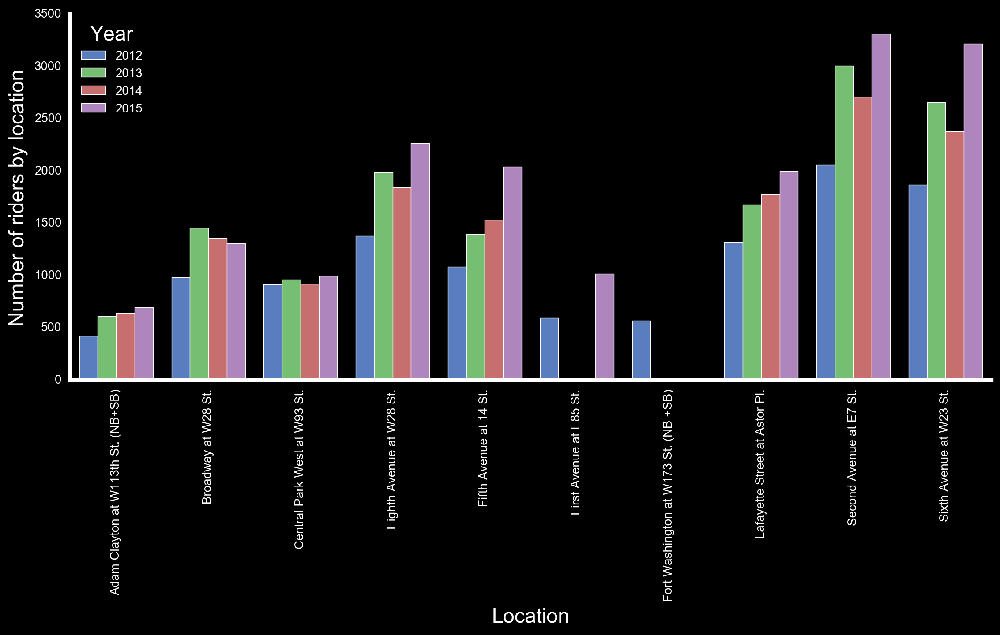

In [355]:
## there is an obvious upward trend of cyclists in Manhattan (where the counts were taking place)

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')

fig, ax = plt.subplots(figsize=(12,5))

bike_count_plot = sns.barplot(x='Location', y='CyclistVolume', hue='Year', data=bike_count_location_group,palette='muted')
for item in bike_count_plot.get_xticklabels():
    item.set_rotation(90)
    
ax.set_ylabel('Number of riders by location')
ax.grid(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.plot();

In [28]:
## setting up these additional features to show the percentage of riders wearing helmets vs. the overall trend of 
## volume of cyclists on the road

bike_count['m_helmet_ratio'] = (bike_count['Male_Cyc_Helmet'] / bike_count['MaleCyc_Total'])
bike_count['f_helmet_ratio'] = (bike_count['Female_Cyc_Helmet'] / bike_count['FemaleCyc_Total'])
bike_count['total_helmet_ratio'] = (bike_count['Cycl_Helmet_all'] / bike_count['CyclistVolume'])
all_helmet_groupby = bike_count.groupby(['Year'], as_index=False)['total_helmet_ratio'].mean()
helmet_groupby = bike_count.groupby(['Year'], as_index=False)[['m_helmet_ratio', 'f_helmet_ratio']].mean()

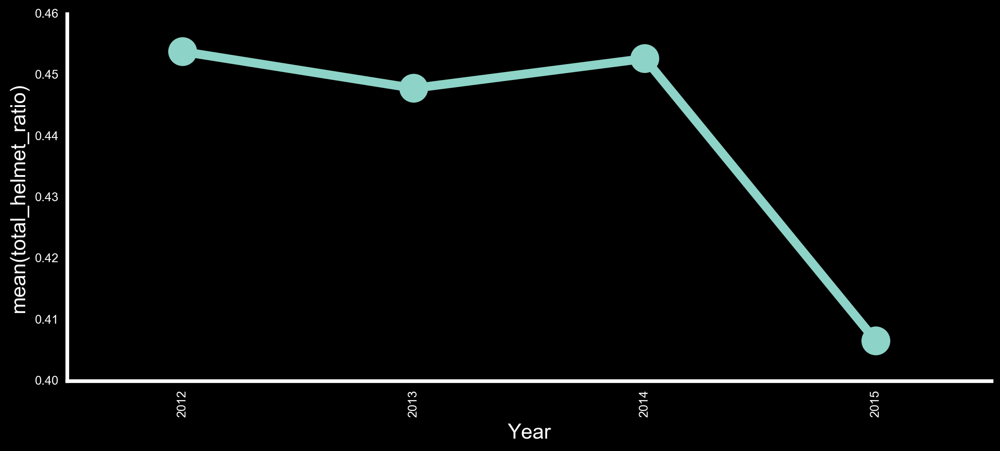

In [98]:
## plotting the ratio of the number of cyclists who wear helmets vs. total cyclists

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
bike_helmet_plot = sns.pointplot(x='Year', y='total_helmet_ratio', data=all_helmet_groupby)
for item in bike_helmet_plot.get_xticklabels():
    item.set_rotation(90)

ax.grid(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.plot();

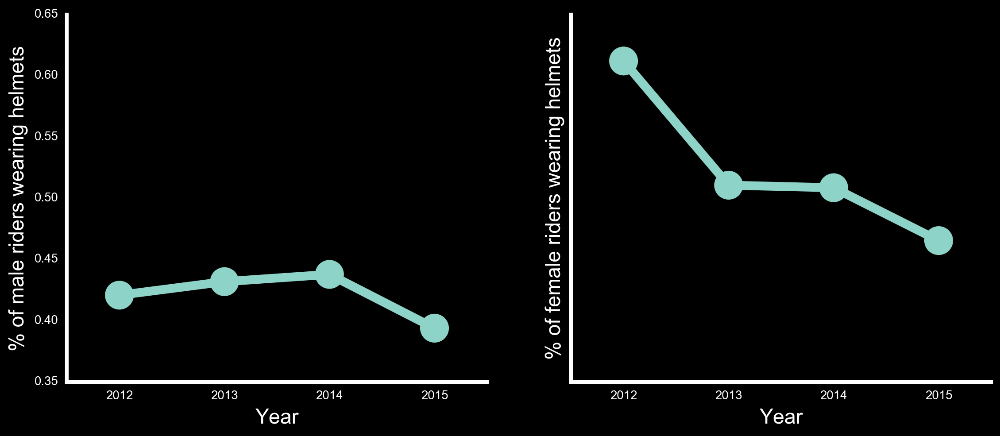

In [93]:
## I am noticing a slight downward trend of riders wearing helmets, vs. the increase of total number of riders
## 

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(12,5))
sns.pointplot(x='Year', y='m_helmet_ratio', data=helmet_groupby, ax=ax1)
sns.pointplot(x='Year', y='f_helmet_ratio', data=helmet_groupby, ax=ax2)

ax.legend(loc='upper left')
ax1.set_ylabel('% of male riders wearing helmets')
ax2.set_ylabel('% of female riders wearing helmets')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.spines['left'].set_visible(True)
ax1.spines['bottom'].set_visible(True)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['left'].set_visible(True)
ax2.spines['bottom'].set_visible(True)
ax1.yaxis.set_ticks_position('left')
ax1.xaxis.set_ticks_position('bottom')
ax2.yaxis.set_ticks_position('left')
ax2.xaxis.set_ticks_position('bottom')
ax1.grid(False)
ax2.grid(False)
plt.plot();

In [34]:
## grouping the cyclist count dataset by year

count_group = bike_count.groupby(['Year'])[['MaleCyc_Total', 'FemaleCyc_Total']].sum().reset_index()
count_group.columns = [['year', 'm_cyclists', 'f_cyclists']]

# # ## creating a total column that is the sum of both male and female riders 
count_group['total_cyclists'] = count_group['m_cyclists'] + count_group['f_cyclists']

# # ## assigning the year column to be the index of the df
count_group.index = count_group['year']


In [35]:
count_group.columns

Index([u'year', u'm_cyclists', u'f_cyclists', u'total_cyclists'], dtype='object')

In [64]:
def adjust_spines(ax, spines):
    for loc, spine in ax.spines.items():
        if loc in spines:
            spine.set_position(('outward', 10)) 
            spine.set_smart_bounds(True)
        else:
            spine.set_color('none')

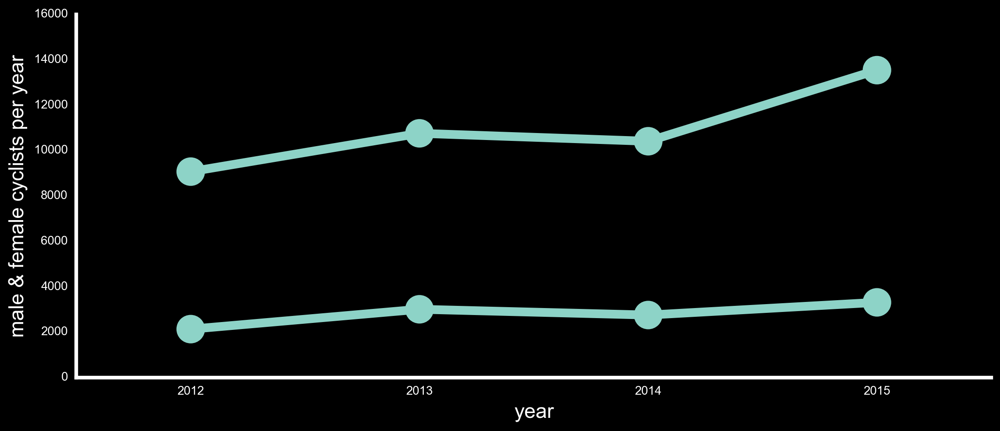

In [90]:
plt.style.use('fivethirtyeight')
plt.style.use('dark_background')

fig, ax1 = plt.subplots(figsize=(12,5))

sns.pointplot(x='year', y='m_cyclists', data=count_group, ax=ax1)
sns.pointplot(x='year', y='f_cyclists', data=count_group, ax=ax1)

ax1.legend(loc='upper left')
ax1.set_ylabel('male & female cyclists per year')
ax1.yaxis.set_ticks_position('left')
ax1.xaxis.set_ticks_position('bottom')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
# adjust_spines(ax, ['left'])
ax1.grid(False)
plt.plot();

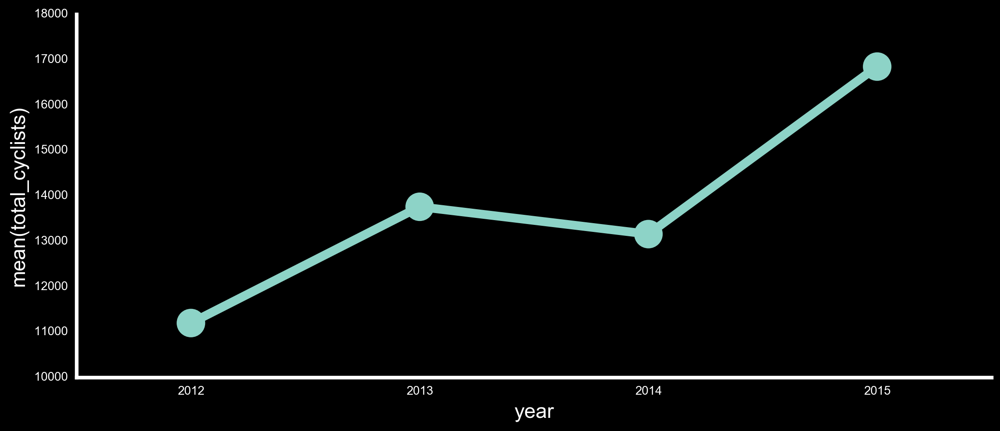

In [88]:
plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))

sns.pointplot(x='year', y='total_cyclists', data=count_group)
ax.grid(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.yaxis.set_ticks_position('none')
# ax.xaxis.set_ticks_position('none')
plt.plot();

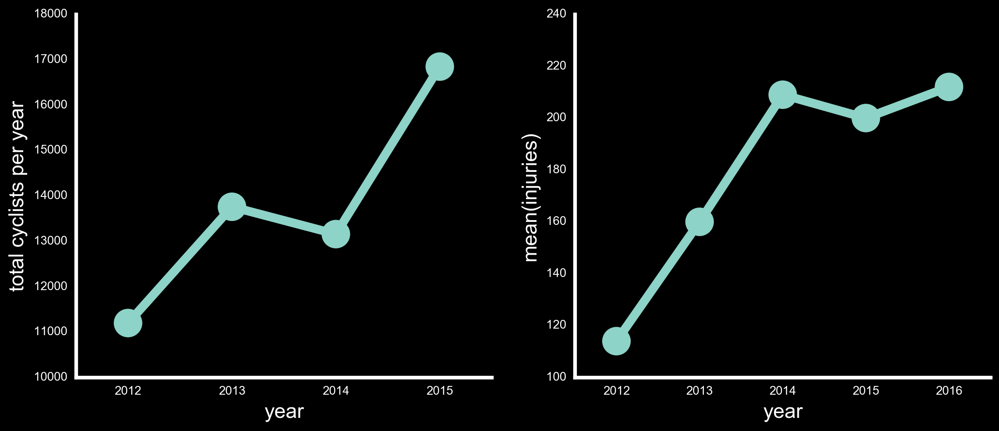

In [86]:
## plotting the number of injuries across the four years against the number of cyclists across those same four years

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')

fig, (ax, ax1) = plt.subplots(ncols=2, sharey=False, figsize=(12,5))
sns.pointplot(x='year', y='total_cyclists', data=count_group, ax=ax)
sns.pointplot(x='year', y='injuries', data=NY_injury_groupby, ax=ax1)
ax.legend(loc='upper right')
ax.set_ylabel('total cyclists per year')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('none')
ax.xaxis.set_ticks_position('none')
ax1.yaxis.set_ticks_position('none')
ax1.xaxis.set_ticks_position('none')
ax.grid(False)
ax1.grid(False)
plt.legend(loc='upper left')
plt.plot();

In [146]:
## masking my dataset so that the only data that shows is instances in which cycling accidents have occurred and where
## the borough is not '0'

NY_mask = NY_merged_samp[NY_merged_samp['BOROUGH'] != 0]
NY_mask = NY_mask[NY_mask['injuries'] != 0]

## mask for data where only injuries have occured, regardless of borough
NY_mask_ = NY_merged_samp[NY_merged_samp['injuries'] == 0]

## grouping my mask by year so i can plot the trend of number of injuries against the trend of number of cyclists
NY_injury_groupby = NY_mask.groupby(['year'], as_index=False)['injuries'].sum()

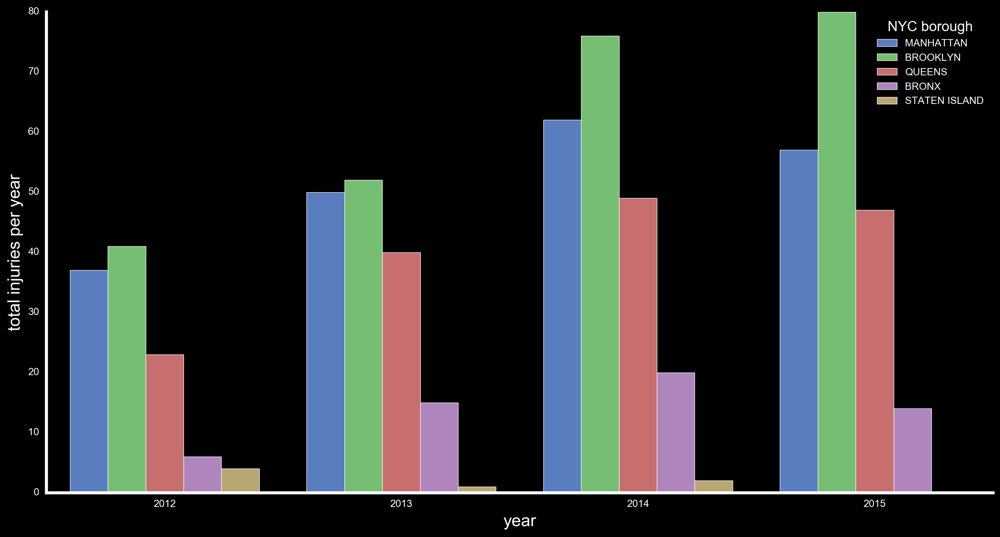

In [343]:
## plotting the number of cycling injuries by for each borough over the span of five years

fig, ax = plt.subplots(figsize=(15,8))
plt.style.use('dark_background')
sns.countplot(x='year', data=NY_mask, hue='BOROUGH',palette='muted')
ax.set_ylabel('total injuries per year')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
ax.grid(False)
plt.legend(loc='upper right', title='NYC borough')
plt.plot();

In [150]:
cloud_df = NY_merged_samp[NY_merged_samp['clouds'] > 0]
cloud_df = cloud_df[cloud_df['BOROUGH'] != 0]

In [181]:
cloud_df

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
6444,2012-07-12,10,MANHATTAN,10022.0,40.757382,-73.966702,"(40.7573816, -73.9667018)",EAST 54 STREET,2 AVENUE,0,...,0,7,0,5,4,4,mid-morning,3,2012,Jul
303788,2013-12-31,12,QUEENS,11101.0,40.745238,-73.937696,"(40.7452378, -73.9376959)",THOMSON AVENUE,SKILLMAN AVENUE,0,...,0,12,0,3,2,4,mid-morning,1,2013,Dec
335899,2014-02-27,9,MANHATTAN,10011.0,40.748891,-74.007023,"(40.7488912, -74.0070233)",WEST 23 STREET,11 AVENUE,0,...,0,2,0,3,2,3,mid-morning,3,2014,Feb
333902,2014-02-24,15,BROOKLYN,11230.0,40.635240,-73.967628,"(40.6352397, -73.9676275)",CONEY ISLAND AVENUE,18 AVENUE,0,...,0,2,0,3,2,4,afternoon,0,2014,Feb
722872,2015-12-22,17,BRONX,10468.0,40.860577,-73.902546,"(40.860577, -73.9025461)",JEROME AVENUE,EAST 184 STREET,0,...,1,12,0,4,4,5,evening,1,2015,Dec
55963,2012-10-10,14,BRONX,10463.0,40.882769,-73.888598,"(40.882769, -73.8885978)",SEDGEWICK AVENUE,DICKINSON AVENUE,0,...,1,10,0,4,4,5,afternoon,2,2012,Oct
269256,2013-11-01,13,QUEENS,11106.0,40.757380,-73.926903,"(40.7573797, -73.9269028)",33 STREET,35 AVENUE,0,...,1,11,0,5,4,5,afternoon,4,2013,Nov
172227,2013-05-15,9,MANHATTAN,10019.0,40.765520,-73.980037,"(40.7655201, -73.9800367)",WEST 57 STREET,7 AVENUE,0,...,0,5,0,5,4,4,mid-morning,2,2013,May
421389,2014-07-29,13,BROOKLYN,11231.0,40.682957,-73.997873,"(40.6829568, -73.9978727)",UNION STREET,CLINTON STREET,0,...,0,7,0,5,4,4,afternoon,1,2014,Jul
449294,2014-09-16,18,BRONX,10461.0,40.851872,-73.853768,"(40.8518715, -73.8537678)",TOMLINSON AVENUE,RHINELANDER AVENUE,0,...,1,9,0,5,4,5,evening,1,2014,Sep


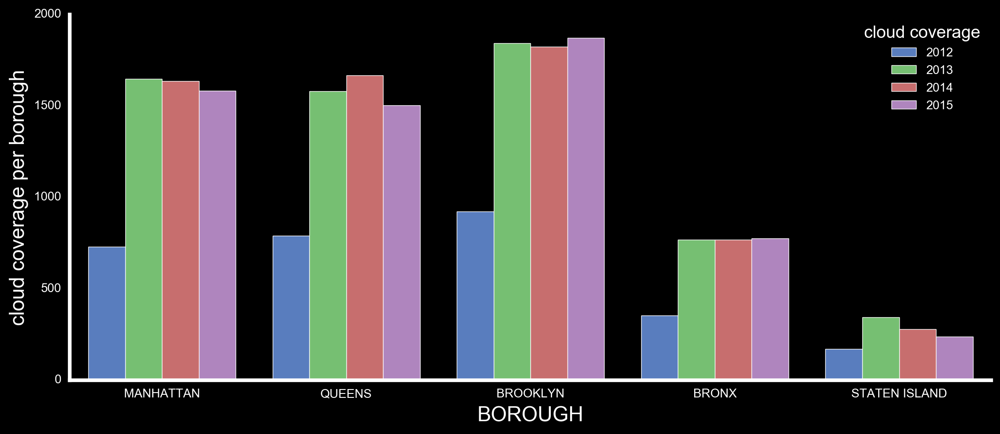

In [344]:
## plotting the total cloud coverage by borough by year

fig, ax = plt.subplots(figsize=(12,5))
plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
sns.countplot(x='BOROUGH', data=cloud_df, hue='year', palette='muted')
ax.set_ylabel('cloud coverage per borough')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
ax.grid(False)
plt.legend(loc='upper right', title='cloud coverage')
plt.plot();

In [152]:
rain_df = NY_merged_samp[(NY_merged_samp['BOROUGH'] != 0) & (NY_merged_samp['precip'] > 0)]

In [185]:
rain_df = rain_df.groupby(['BOROUGH','year'], as_index=False)['precip'].sum()

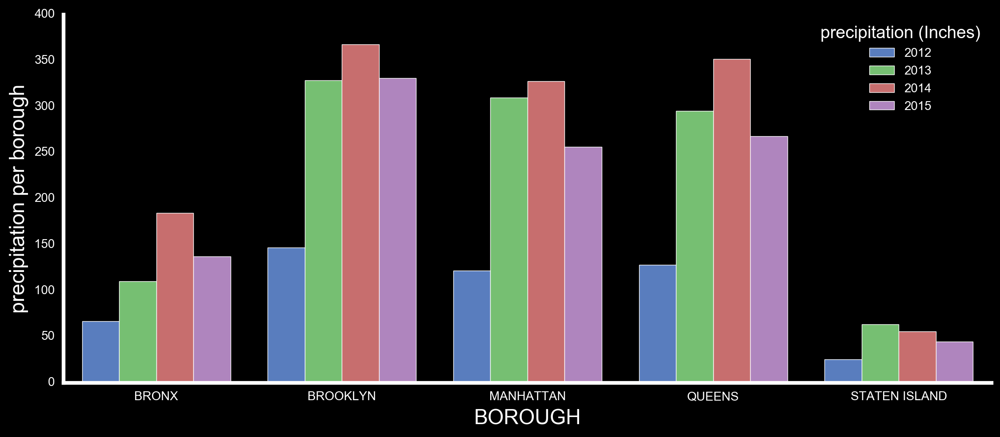

In [345]:
## plotting the amount of precipitation per borough per year

fig, ax = plt.subplots(figsize=(12,5))
plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
sns.barplot(x='BOROUGH', y='precip',data=rain_df, hue='year', palette='muted')
ax.set_ylabel('precipitation per borough')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
ax.grid(False)
plt.legend(loc='upper right', title='precipitation (Inches)')
plt.plot();

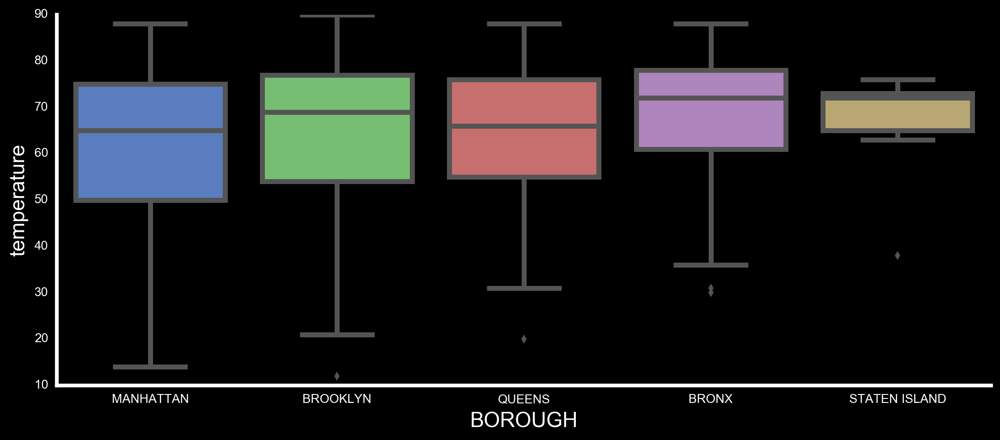

In [346]:
## plotting the mean temperature by borough

fig, ax = plt.subplots(figsize=(12,5))
plt.style.use('dark_background')
sns.boxplot(x='BOROUGH',y='mean_temp',data=NY_mask, palette='muted')
ax.legend(loc='upper right')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
ax.grid(False)
ax.legend(loc='lower right', title='mean temperature')
ax.set_ylabel('temperature')
plt.plot();

In [184]:
NY_mask.groupby(['BOROUGH', 'year'])['injuries'].sum()

BOROUGH        year
BRONX          2012     6
               2013    15
               2014    20
               2015    14
BROOKLYN       2012    43
               2013    52
               2014    76
               2015    81
MANHATTAN      2012    37
               2013    51
               2014    62
               2015    57
QUEENS         2012    24
               2013    41
               2014    49
               2015    48
STATEN ISLAND  2012     4
               2013     1
               2014     2
Name: injuries, dtype: int64

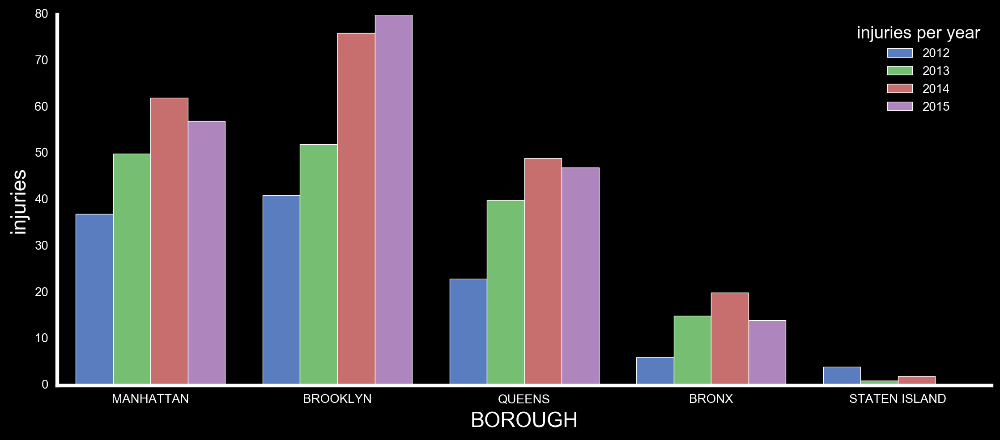

In [347]:
## plotting the amount of injuries per year per borough to see the upwards trend

fig, ax = plt.subplots(figsize=(12,5))
plt.style.use('dark_background')

sns.countplot(x='BOROUGH',data=NY_mask, hue='year', palette='muted')
ax.legend(loc = 'upper left')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
plt.legend(loc='upper right', title='injuries per year')
ax.set_ylabel('injuries')
ax.grid(False)
plt.plot();

In [192]:
## creating dataframes for all the different boroughs so I can get deeper into the analysis by location

manhattan_df = NY_merged_samp[NY_merged_samp['BOROUGH'] == 'MANHATTAN']
brooklyn_df = NY_merged_samp[NY_merged_samp['BOROUGH'] == 'BROOKLYN']
staten_df = NY_merged_samp[NY_merged_samp['BOROUGH'] == 'STATEN ISLAND']
queens_df = NY_merged_samp[NY_merged_samp['BOROUGH'] == 'QUEENS']
bronx_df = NY_merged_samp[NY_merged_samp['BOROUGH'] == 'BRONX']

In [ ]:
## creating a df that only contains the total number of male and female cyclists with the corresponding number of 
## riders that were wearing a helmet 

bike_helmet_group = bike_count.groupby(['Year'], as_index=False)[['Male_Cyc_Helmet','Female_Cyc_Helmet',
                                                                  'MaleCyc_Total','FemaleCyc_Total','CyclistVolume']].sum()

In [229]:
manhattan_df.columns

Index([u'DATE', u'TIME', u'BOROUGH', u'ZIP_CODE', u'LATITUDE', u'LONGITUDE',
       u'LOCATION', u'ON_STREET_NAME', u'CROSS_STREET_NAME',
       u'OFF_STREET_NAME', u'NUMBER_OF_PERSONS_INJURED',
       u'NUMBER_OF_PERSONS_KILLED', u'NUMBER_OF_PEDESTRIANS_INJURED',
       u'NUMBER_OF_PEDESTRIANS_KILLED', u'injuries', u'deaths',
       u'NUMBER_OF_MOTORIST_INJURED', u'NUMBER_OF_MOTORIST_KILLED',
       u'vehicle_1', u'CONTRIBUTING_FACTOR_VEHICLE_2',
       u'CONTRIBUTING_FACTOR_VEHICLE_3', u'CONTRIBUTING_FACTOR_VEHICLE_4',
       u'CONTRIBUTING_FACTOR_VEHICLE_5', u'UNIQUE_KEY', u'VEHICLE_TYPE_CODE_1',
       u'VEHICLE_TYPE_CODE_2', u'VEHICLE_TYPE_CODE_3', u'VEHICLE_TYPE_CODE_4',
       u'VEHICLE_TYPE_CODE_5', u'max_temp', u'mean_temp', u'min_temp',
       u'max_dew', u'mean_dew', u'min_dew', u'max_humid', u'mean_humid',
       u'min_humid', u'_Max_Sea_Level_PressureIn',
       u'_Mean_Sea_Level_PressureIn', u'_Min_Sea_Level_PressureIn',
       u'max_visible', u'mean_visible', u'min_visib

In [232]:
manhattan_weather_group = manhattan_df.groupby(['year'], as_index=False)[['precip', 'clouds', 'mean_visible']].mean()

In [233]:
manhattan_weather_group

,year,precip,clouds,mean_visible
0,2012,0.126180,3.167702,8.699793
1,2013,0.149134,3.333494,8.556785
2,2014,0.156391,3.374224,8.532220
3,2015,0.119154,3.139870,8.419145


In [234]:
## creating the features in the dataframe so I can then plot out the different ratios: 
## % of cyclists injured, % of male vs. female cyclists wearing a helmet
## also want to see if there's any relationship between the injury ratio and the different weather features for manhattan

manhattan_injury_ratio_df = manhattan_df.groupby(['year'], as_index=False)['injuries','deaths'].sum()
manhattan_injury_ratio_df['m_cyclists'] = bike_helmet_group['MaleCyc_Total']
manhattan_injury_ratio_df['f_cyclists'] = bike_helmet_group['FemaleCyc_Total']
manhattan_injury_ratio_df['total_cyclists'] = bike_helmet_group['CyclistVolume']
manhattan_injury_ratio_df['m_helmets'] = bike_helmet_group['Male_Cyc_Helmet']
manhattan_injury_ratio_df['f_helmets'] = bike_helmet_group['Female_Cyc_Helmet']
manhattan_injury_ratio_df['precip'] = manhattan_weather_group['precip']
manhattan_injury_ratio_df['clouds'] = manhattan_weather_group['clouds']
manhattan_injury_ratio_df['visibility'] = manhattan_weather_group['mean_visible']

In [235]:
manhattan_injury_ratio_df['injury_ratio'] = manhattan_injury_ratio_df['injuries'] / manhattan_injury_ratio_df['total_cyclists']
manhattan_injury_ratio_df['m_helmet_ratio'] = manhattan_injury_ratio_df['m_helmets'] / manhattan_injury_ratio_df['m_cyclists']
manhattan_injury_ratio_df['f_helmet_ratio'] = manhattan_injury_ratio_df['f_helmets'] / manhattan_injury_ratio_df['f_cyclists']

In [236]:
manhattan_injury_ratio_df

,year,injuries,deaths,m_cyclists,f_cyclists,total_cyclists,m_helmets,f_helmets,precip,clouds,visibility,injury_ratio,m_helmet_ratio,f_helmet_ratio
0,2012,37,0,9069,2130,11199,3822,1230,0.126180,3.167702,8.699793,0.003304,0.421436,0.577465
1,2013,51,0,10756,3004,13760,4744,1494,0.149134,3.333494,8.556785,0.003706,0.441056,0.497337
2,2014,62,1,10407,2751,13158,4510,1369,0.156391,3.374224,8.532220,0.004712,0.433362,0.497637
3,2015,57,1,13539,3309,16848,5303,1477,0.119154,3.139870,8.419145,0.003383,0.391683,0.446358


In [303]:
manhattan_weather_group

,year,precip,clouds,mean_visible
0,2012,0.126180,3.167702,8.699793
1,2013,0.149134,3.333494,8.556785
2,2014,0.156391,3.374224,8.532220
3,2015,0.119154,3.139870,8.419145


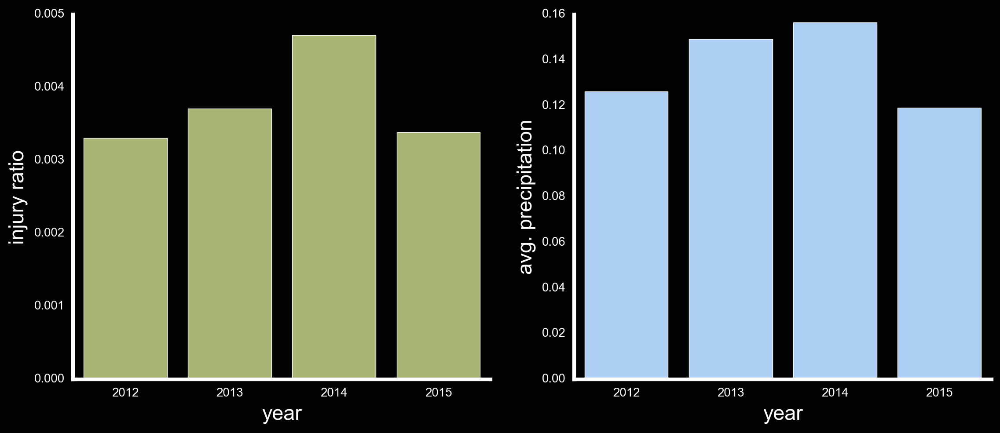

In [319]:
## now plotting the injury ratios against the precipitation amount

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
sns.color_palette("muted")

fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=False,figsize=(12,5))
sns.barplot(x='year', y='injury_ratio', data=manhattan_injury_ratio_df, ax=ax1, color='#acbf69')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.yaxis.set_ticks_position('left')
ax1.xaxis.set_ticks_position('bottom')
ax1.set_ylabel('injury ratio')
ax1.grid(False)

sns.barplot(x='year', y='precip', data=manhattan_weather_group, ax=ax2, color='#a2cffe')
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.yaxis.set_ticks_position('left')
ax2.xaxis.set_ticks_position('bottom')
ax2.set_ylabel('avg. precipitation')
ax2.grid(False)
plt.plot();


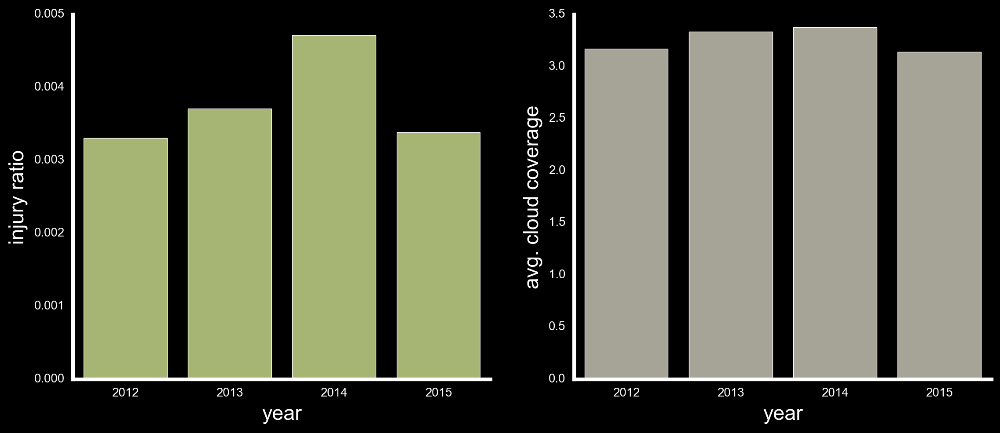

In [332]:
## now plotting the injury ratios against the amount of cloud coverage

plt.style.use('fivethirtyeight')
plt.style.use('dark_background')
sns.color_palette("muted")

fig, (ax1, ax3) = plt.subplots(ncols=2, sharey=False,figsize=(12,5))
sns.barplot(x='year', y='injury_ratio', data=manhattan_injury_ratio_df, ax=ax1, color='#acbf69')
plt.legend(loc='lower right')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.yaxis.set_ticks_position('left')
ax1.xaxis.set_ticks_position('bottom')
ax1.set_ylabel('injury ratio')
ax1.grid(False)

sns.barplot(x='year', y='clouds', data=manhattan_injury_ratio_df, ax=ax3, color= '#a8a495')
plt.legend(loc='lower right')
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax3.yaxis.set_ticks_position('left')
ax3.xaxis.set_ticks_position('bottom')
ax3.set_ylabel('avg. cloud coverage')
ax3.grid(False)
plt.plot();

In [249]:
manhattan_visibility_df = manhattan_weather_group.groupby(['year'], as_index=False)['mean_visible'].mean()

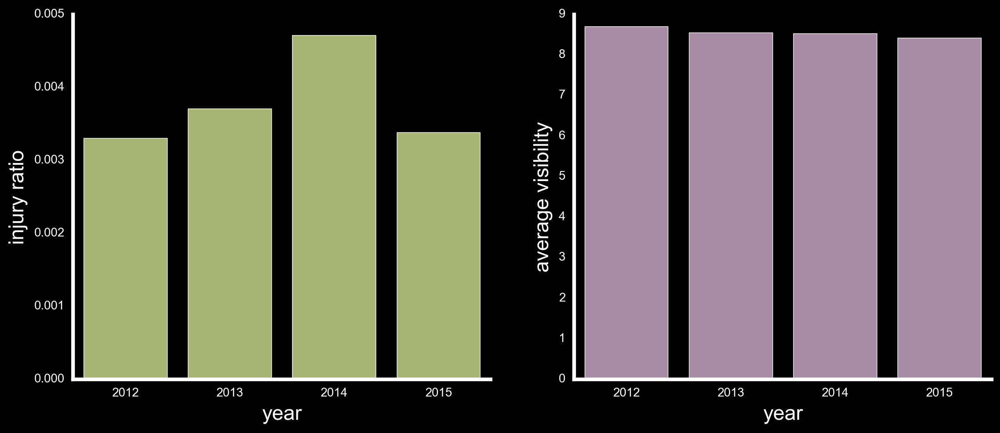

In [330]:
fig, (ax1, ax4) = plt.subplots(ncols=2, sharey=False,figsize=(12,5))
sns.barplot(x='year', y='injury_ratio', data=manhattan_injury_ratio_df, ax=ax1, color='#acbf69')
plt.legend(loc='lower right')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.yaxis.set_ticks_position('left')
ax1.xaxis.set_ticks_position('bottom')
ax1.set_ylabel('injury ratio')
ax1.grid(False)

sns.barplot(x='year',y='mean_visible', data=manhattan_visibility_df, ax=ax4, color='#ac86a8')
plt.legend(loc='lower right')
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax4.yaxis.set_ticks_position('left')
ax4.xaxis.set_ticks_position('bottom')
ax4.grid(False)
ax4.set_ylabel('average visibility')
plt.plot();

In [357]:
## getting the manhattan df read to plot all the coordinates where there was an accident

manhattan_injuries = manhattan_df[manhattan_df['injuries'] > 0]
manhattan_injuries

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
67761,2012-11-01,12,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 AVENUE,EAST 23 STREET,0,...,0,11,1,4,3,5,mid-morning,3,2012,Nov
147611,2013-04-02,13,MANHATTAN,10009.0,40.729432,-73.978027,"(40.7294318, -73.978027)",EAST 14 STREET,AVENUE B,0,...,0,4,1,3,2,3,afternoon,1,2013,Apr
25538,2012-08-16,6,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 AVENUE,EAST 23 STREET,0,...,0,8,1,5,5,5,early_morning,3,2012,Aug
157301,2013-04-19,20,MANHATTAN,10003.0,40.731322,-73.988613,"(40.7313217, -73.9886127)",3 AVENUE,EAST 11 STREET,0,...,1,4,1,5,4,5,late-night,4,2013,Apr
167754,2013-05-08,19,MANHATTAN,10021.0,40.771696,-73.959182,"(40.7716958, -73.9591816)",3 AVENUE,EAST 75 STREET,0,...,4,5,1,4,4,6,evening,2,2013,May
193161,2013-06-19,16,MANHATTAN,10012.0,40.728067,-73.998954,"(40.728067, -73.9989537)",LAGUARDIA PLACE,BLEECKER STREET,0,...,1,6,1,5,4,5,evening,2,2013,Jun
440319,2014-09-01,7,MANHATTAN,10026.0,40.803216,-73.952531,"(40.8032165, -73.9525305)",WEST 116 STREET,7 AVENUE,0,...,0,9,1,6,5,5,mid-morning,0,2014,Sep
634260,2015-08-02,16,MANHATTAN,10030.0,40.817846,-73.941844,"(40.8178464, -73.9418441)",WEST 139 STREET,7 AVENUE,0,...,0,8,1,5,4,4,evening,6,2015,Aug
427567,2014-08-09,12,MANHATTAN,10002.0,40.721473,-73.983823,"(40.721473, -73.9838235)",EAST HOUSTON STREET,CLINTON STREET,0,...,0,8,1,5,4,4,mid-morning,5,2014,Aug
221541,2013-08-07,9,MANHATTAN,10001.0,40.748469,-73.992461,"(40.7484685, -73.9924606)",WEST 30 STREET,7 AVENUE,0,...,0,8,1,5,5,5,mid-morning,2,2013,Aug


In [370]:
manhattan_injuries_groupby = manhattan_injuries.groupby(['year','ON_STREET_NAME'],as_index=False)['injuries'].sum()

In [372]:
manhattan_injuries_groupby.sort_values(by='injuries', axis=0, ascending=False, inplace=True)

In [374]:
manhattan_injuries_groupby = manhattan_injuries_groupby.head(10)

In [380]:
manhattan_injuries_groupby

,year,ON_STREET_NAME,injuries
146,2015,BROADWAY,4
143,2015,9 AVENUE,3
3,2012,5 AVENUE,3
115,2014,WEST 116 STREET,3
17,2012,EAST HOUSTON STREET,2
31,2013,3 AVENUE,2
158,2015,EAST 72 STREET,2
37,2013,BROADWAY,2
151,2015,EAST 116 STREET,2
148,2015,DELANCEY STREET,2


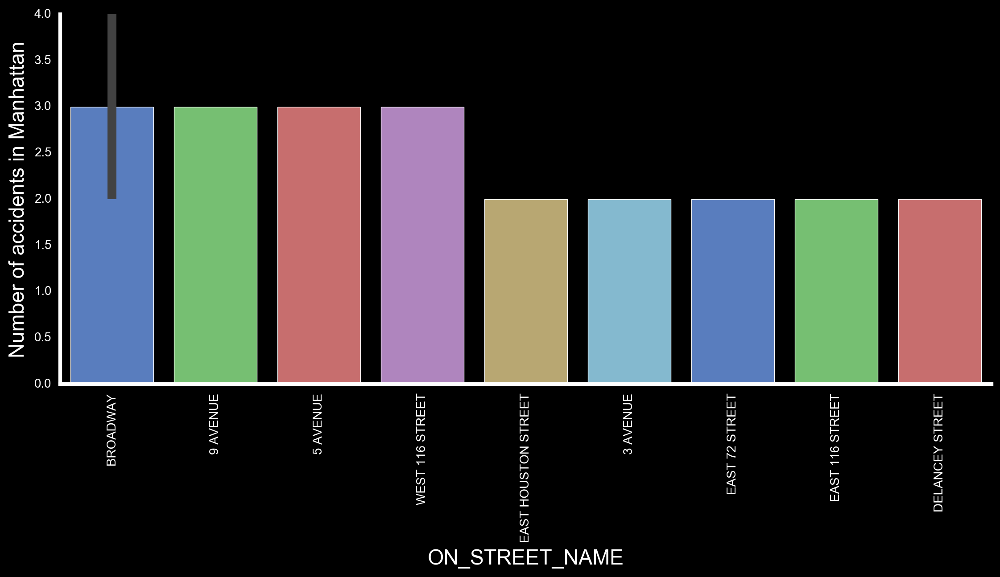

In [384]:
plt.style.use('fivethirtyeight')
plt.style.use('dark_background')

fig, ax = plt.subplots(figsize=(12,5))

manhattan_injury_plot = sns.barplot(x='ON_STREET_NAME', y='injuries', data=manhattan_injuries_groupby ,palette='muted')
for item in manhattan_injury_plot.get_xticklabels():
    item.set_rotation(90)
    
ax.set_ylabel('Number of accidents in Manhattan')
ax.grid(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.plot();

In [386]:
manhattan_df

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
6444,2012-07-12,10,MANHATTAN,10022.0,40.757382,-73.966702,"(40.7573816, -73.9667018)",EAST 54 STREET,2 AVENUE,0,...,0,7,0,5,4,4,mid-morning,3,2012,Jul
335899,2014-02-27,9,MANHATTAN,10011.0,40.748891,-74.007023,"(40.7488912, -74.0070233)",WEST 23 STREET,11 AVENUE,0,...,0,2,0,3,2,3,mid-morning,3,2014,Feb
172227,2013-05-15,9,MANHATTAN,10019.0,40.765520,-73.980037,"(40.7655201, -73.9800367)",WEST 57 STREET,7 AVENUE,0,...,0,5,0,5,4,4,mid-morning,2,2013,May
233350,2013-08-29,16,MANHATTAN,10027.0,40.807338,-73.964390,"(40.8073378, -73.9643903)",BROADWAY,WEST 115 STREET,0,...,0,8,0,5,5,5,evening,3,2013,Aug
78160,2012-11-20,11,MANHATTAN,10016.0,40.741275,-73.975342,"(40.7412749, -73.9753418)",EAST 30 STREET,1 AVENUE,0,...,0,11,0,4,3,5,mid-morning,1,2012,Nov
260652,2013-10-17,9,MANHATTAN,10036.0,40.758429,-73.992633,"(40.7584292, -73.9926328)",WEST 42 STREET,9 AVENUE,0,...,1,10,0,5,4,5,mid-morning,3,2013,Oct
490943,2014-11-26,19,MANHATTAN,10024.0,40.779479,-73.973573,"(40.7794786, -73.9735729)",CENTRAL PARK WEST,WEST 77 STREET,0,...,2,11,0,4,3,5,evening,2,2014,Nov
83882,2012-12-01,20,MANHATTAN,10028.0,40.780230,-73.961368,"(40.7802299, -73.9613681)",EAST 84 STREET,5 AVENUE,0,...,0,12,0,3,3,6,late-night,5,2012,Dec
228785,2013-08-21,14,MANHATTAN,10001.0,40.748438,-73.996196,"(40.7484385, -73.996196)",8 AVENUE,WEST 28 STREET,0,...,0,8,0,6,5,4,afternoon,2,2013,Aug
81300,2012-11-27,16,MANHATTAN,10028.0,40.775929,-73.947123,"(40.7759287, -73.9471233)",EAST 86 STREET,YORK AVENUE,0,...,1,11,0,3,3,5,evening,1,2012,Nov


In [389]:
stamen = folium.Map(location=[40.7347476, -73.9122528], zoom_start=11, tiles='mapquestopen')

for y, x in manhattan_df[['LATITUDE', 'LONGITUDE']].values:
    folium.Marker(location=[y, x]).add_to(stamen)
    
stamen

In [331]:
## seasonal analysis:

## I wanted to separate my data into different segments so that I could compare certain features/trends across the 5
## years.

NY_spring_13 = segment_func(NY_merged_samp, '03/20/2013', '06/21/2013')
NY_spring_14 = segment_func(NY_merged_samp, '03/20/2014', '06/21/2014')
NY_spring_15 = segment_func(NY_merged_samp, '03/20/2015', '06/21/2015')
NY_spring_16 = segment_func(NY_merged_samp, '03/20/2016', '06/21/2016')
NY_summer_13 = segment_func(NY_merged_samp, '06/22/2013', '09/22/2013')
NY_summer_14 = segment_func(NY_merged_samp, '06/22/2014', '09/22/2014')
NY_summer_15 = segment_func(NY_merged_samp, '06/22/2015', '09/22/2015')
NY_summer_16 = segment_func(NY_merged_samp, '06/22/2016', '09/22/2016')
NY_fall_13 = segment_func(NY_merged_samp, '09/23/2013', '12/21/2013')
NY_fall_14 = segment_func(NY_merged_samp, '09/23/2014', '12/21/2014')
NY_fall_15 = segment_func(NY_merged_samp, '09/23/2015', '12/21/2015')
NY_fall_16 = segment_func(NY_merged_samp, '09/23/2016', '12/21/2016')
NY_winter_13a = segment_func(NY_merged_samp, '01/01/2013', '03/19/2013')
NY_winter_13b = segment_func(NY_merged_samp, '12/22/2013', '12/31/2013')
NY_winter_14a = segment_func(NY_merged_samp, '01/01/2014', '03/19/2014')
NY_winter_14b = segment_func(NY_merged_samp, '12/22/2014', '12/31/2014')
NY_winter_15a = segment_func(NY_merged_samp, '01/01/2015', '03/19/2015')
NY_winter_15b = segment_func(NY_merged_samp, '12/22/2015', '12/31/2015')
NY_winter_16a = segment_func(NY_merged_samp, '01/01/2016', '03/19/2016')
NY_winter_16b = segment_func(NY_merged_samp, '12/22/2016', '12/31/2016')

NY_winter_13 = segment_func(NY_merged_samp, '01/01/2013', '03/19/2013')
NY_winter_14 = segment_func(NY_merged_samp, '12/22/2013', '03/19/2014')
NY_winter_15 = segment_func(NY_merged_samp, '12/22/2014', '03/19/2015')

NY_spring = NY_spring_13.append(NY_spring_14.append(NY_spring_15.append(NY_spring_16)))
NY_summer = NY_summer_13.append(NY_summer_14.append(NY_summer_15.append(NY_summer_16)))
NY_fall = NY_fall_13.append(NY_fall_14.append(NY_fall_15.append(NY_fall_16)))
NY_winter_a = NY_winter_13a.append(NY_winter_14a.append(NY_winter_15a.append(NY_winter_16a)))
NY_winter_b = NY_winter_13b.append(NY_winter_14b.append(NY_winter_15b.append(NY_winter_16b)))

NY_spring['month'] = month_extract(NY_spring['DATE'])
NY_summer['month'] = month_extract(NY_summer['DATE'])
NY_winter_a['month'] = month_extract(NY_winter_a['DATE'])
NY_winter_b['month'] = month_extract(NY_winter_b['DATE'])
NY_fall['month'] = month_extract(NY_fall['DATE'])

In [326]:
## renaming the columns of the seasonal dataframes so can distinguish them when plotting

NY_spring.rename(columns={'injuries':'spring_injuries','precip':'spring_precip'}, inplace=True)
NY_summer.rename(columns={'injuries':'summer_injuries','precip':'summer_precip'}, inplace=True)
NY_winter_a.rename(columns={'injuries':'winter_a_injuries','precip':'winter_a_precip'}, inplace=True)
NY_winter_b.rename(columns={'injuries':'winter_b_injuries','precip':'winter_b_precip'}, inplace=True)
NY_fall.rename(columns={'injuries':'fall_injuries','precip':'fall_precip'}, inplace=True)

In [238]:
NY_spring_group = NY_spring.groupby(['month'])['spring_injuries'].sum()

In [244]:
NY_spring_13.head()

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
172227,2013-05-15,9,MANHATTAN,10019.0,40.765520,-73.980037,"(40.7655201, -73.9800367)",WEST 57 STREET,7 AVENUE,0,...,0,5,0,5,4,4,mid-morning,2,2013,May
147248,2013-04-01,11,STATEN ISLAND,10312.0,40.549105,-74.180463,"(40.5491052, -74.1804625)",RATHBUN AVENUE,CARLTON BOULEVARD,0,...,0,4,0,4,3,5,mid-morning,0,2013,Apr
153231,2013-04-12,4,BROOKLYN,11207.0,40.678738,-73.898868,"(40.6787376, -73.8988676)",BUSHWICK AVENUE,FANCHON PLACE,0,...,1,4,0,4,3,6,early_morning,4,2013,Apr
158167,2013-04-21,12,QUEENS,11355.0,40.759687,-73.810676,"(40.7596874, -73.8106755)",155 STREET,BEECH AVENUE,0,...,0,4,0,4,3,3,mid-morning,6,2013,Apr
171749,2013-05-15,14,QUEENS,11697.0,40.554941,-73.927002,"(40.5549412, -73.9270019)",BEACH 219 STREET,BREEZY POINT BOULEVARD,0,...,0,5,0,5,4,4,afternoon,2,2013,May


In [332]:
spring_13 = NY_spring_13.groupby(['month'],as_index=False)['injuries'].sum()
spring_14 = NY_spring_14.groupby(['month'],as_index=False)['injuries'].sum()
spring_15 = NY_spring_15.groupby(['month'],as_index=False)['injuries'].sum()

summer_13 = NY_summer_13.groupby(['month'],as_index=False)['injuries'].sum()
summer_14 = NY_summer_14.groupby(['month'],as_index=False)['injuries'].sum()
summer_15 = NY_summer_15.groupby(['month'],as_index=False)['injuries'].sum()

winter_13 = NY_winter_13.groupby(['month'],as_index=False)['injuries'].sum()
winter_14 = NY_winter_14.groupby(['month'],as_index=False)['injuries'].sum()
winter_15 = NY_winter_15.groupby(['month'],as_index=False)['injuries'].sum()

fall_13 = NY_fall_13.groupby(['month'],as_index=False)['injuries'].sum()
fall_14 = NY_fall_14.groupby(['month'],as_index=False)['injuries'].sum()
fall_15 = NY_fall_15.groupby(['month'],as_index=False)['injuries'].sum()

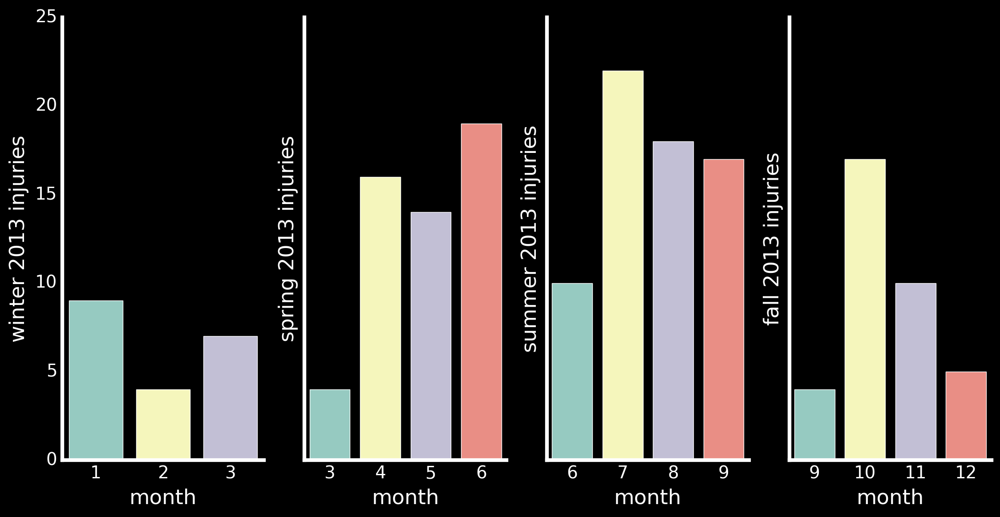

In [339]:
plt.style.use('dark_background')
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, sharey=True, figsize=(12,6))
sns.barplot(x='month', y='injuries', data=winter_13, ax=ax1,hue=None)
sns.barplot(x='month', y='injuries', data=spring_13, ax=ax2,hue=None)
sns.barplot(x='month', y='injuries', data=summer_13, ax=ax3,hue=None)
sns.barplot(x='month', y='injuries', data=fall_13, ax=ax4,hue=None)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax1.grid(False)
ax2.grid(False)
ax3.grid(False)
ax4.grid(False)
ax1.set_ylabel('winter 2013 injuries')
ax2.set_ylabel('spring 2013 injuries')
ax3.set_ylabel('summer 2013 injuries')
ax4.set_ylabel('fall 2013 injuries')
plt.plot();

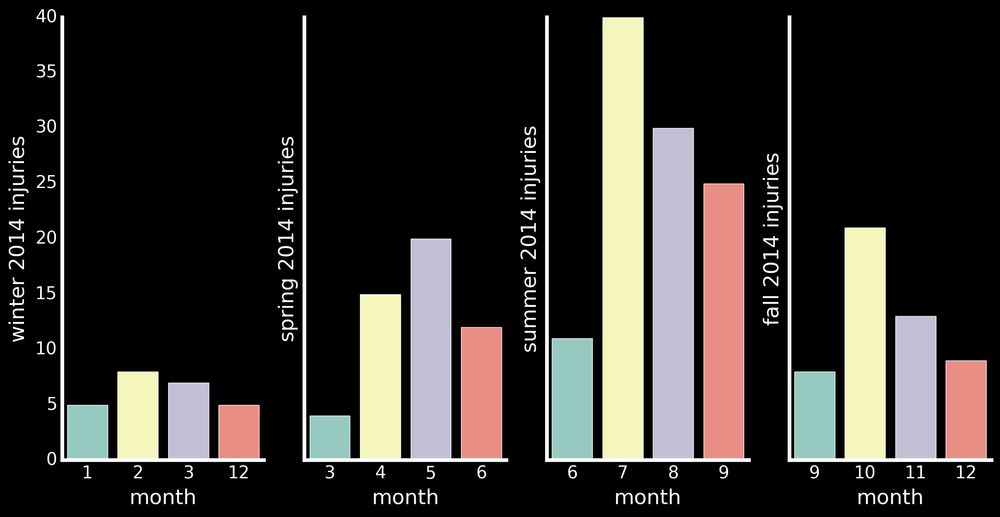

In [338]:
plt.style.use('dark_background')
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, sharey=True, figsize=(12,6))
sns.barplot(x='month', y='injuries', data=winter_14, ax=ax1,hue=None)
sns.barplot(x='month', y='injuries', data=spring_14, ax=ax2,hue=None)
sns.barplot(x='month', y='injuries', data=summer_14, ax=ax3,hue=None)
sns.barplot(x='month', y='injuries', data=fall_14, ax=ax4,hue=None)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax1.grid(False)
ax2.grid(False)
ax3.grid(False)
ax4.grid(False)
ax1.set_ylabel('winter 2014 injuries')
ax2.set_ylabel('spring 2014 injuries')
ax3.set_ylabel('summer 2014 injuries')
ax4.set_ylabel('fall 2014 injuries')
plt.plot();

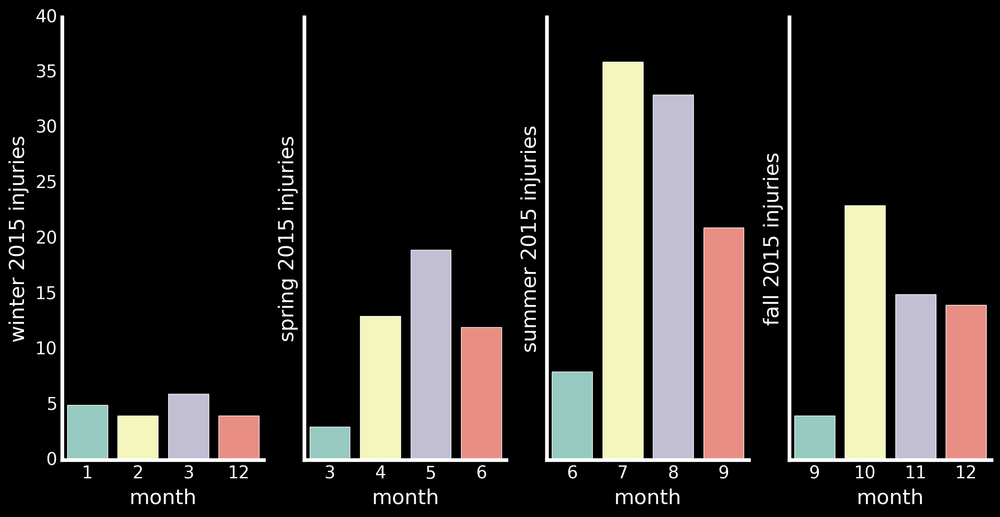

In [340]:
plt.style.use('dark_background')
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, sharey=True, figsize=(12,6))
sns.barplot(x='month', y='injuries', data=winter_15, ax=ax1,hue=None)
sns.barplot(x='month', y='injuries', data=spring_15, ax=ax2,hue=None)
sns.barplot(x='month', y='injuries', data=summer_15, ax=ax3,hue=None)
sns.barplot(x='month', y='injuries', data=fall_15, ax=ax4,hue=None)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax1.grid(False)
ax2.grid(False)
ax3.grid(False)
ax4.grid(False)
ax1.set_ylabel('winter 2015 injuries')
ax2.set_ylabel('spring 2015 injuries')
ax3.set_ylabel('summer 2015 injuries')
ax4.set_ylabel('fall 2015 injuries')
plt.plot();

In [352]:
## creating new dataframes for the precipitation graphs so I can see trends/relationships between amount of rain and the 
## number of accidents

winter_13_p = NY_winter_13.groupby(['month'],as_index=False)['precip'].sum()
winter_14_p = NY_winter_14.groupby(['month'],as_index=False)['precip'].sum()
winter_15_p = NY_winter_15.groupby(['month'],as_index=False)['precip'].sum()

spring_13_p = NY_spring_13.groupby(['month'],as_index=False)['precip'].sum()
spring_14_p = NY_spring_14.groupby(['month'],as_index=False)['precip'].sum()
spring_15_p = NY_spring_15.groupby(['month'],as_index=False)['precip'].sum()

summer_13_p = NY_summer_13.groupby(['month'],as_index=False)['precip'].sum()
summer_14_p = NY_summer_14.groupby(['month'],as_index=False)['precip'].sum()
summer_15_p = NY_summer_15.groupby(['month'],as_index=False)['precip'].sum()

fall_13_p = NY_fall_13.groupby(['month'],as_index=False)['precip'].sum()
fall_14_p = NY_fall_14.groupby(['month'],as_index=False)['precip'].sum()
fall_15_p = NY_fall_15.groupby(['month'],as_index=False)['precip'].sum()

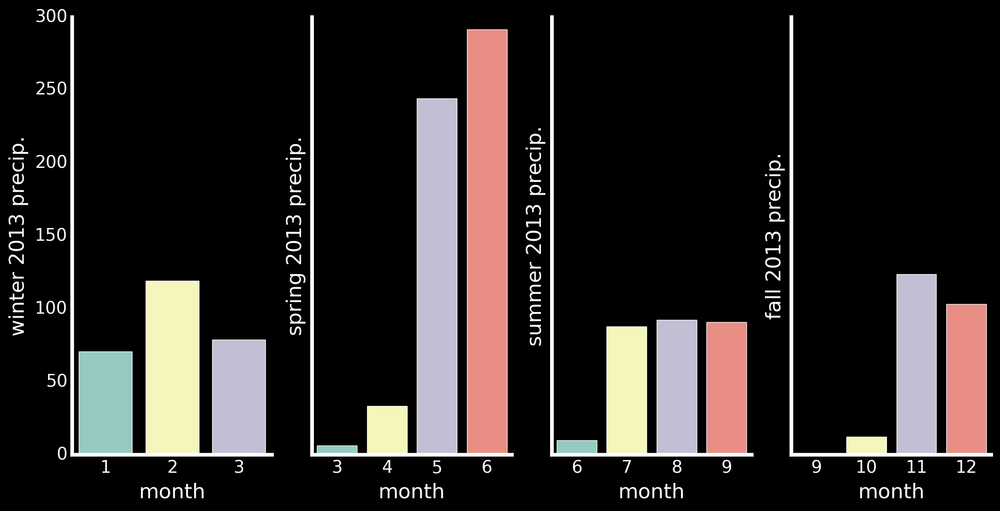

In [353]:
plt.style.use('dark_background')
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols=4, sharey=True, figsize=(12,6))
sns.barplot(x='month', y='precip', data=winter_13_p, ax=ax1,hue=None)
sns.barplot(x='month', y='precip', data=spring_13_p, ax=ax2,hue=None)
sns.barplot(x='month', y='precip', data=summer_13_p, ax=ax3,hue=None)
sns.barplot(x='month', y='precip', data=fall_13_p, ax=ax4,hue=None)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax1.grid(False)
ax2.grid(False)
ax3.grid(False)
ax4.grid(False)
ax1.set_ylabel('winter 2013 precip.')
ax2.set_ylabel('spring 2013 precip.')
ax3.set_ylabel('summer 2013 precip.')
ax4.set_ylabel('fall 2013 precip.')
plt.plot();

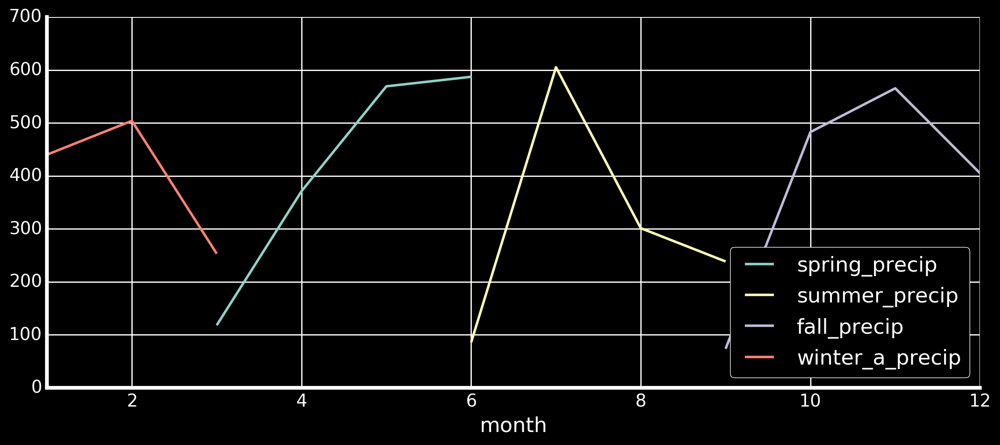

In [345]:
plt.style.use('dark_background')

fig, ax = plt.subplots(figsize=(12,5))

NY_spring.groupby(['month'])['spring_precip'].sum().plot()
NY_summer.groupby(['month'])['summer_precip'].sum().plot()
NY_fall.groupby(['month'])['fall_precip'].sum().plot()
NY_winter_a.groupby(['month'])['winter_a_precip'].sum().plot()

plt.legend(loc='lower right')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
plt.plot();

In [142]:
##separating my sample dataframe out into years to perform timeseries analysis...

bike_2012 = segment_func(NY_merged_samp, '01/01/2012', '12/31/2012')
bike_2013 = segment_func(NY_merged_samp, '01/01/2013', '12/31/2013')
bike_2014 = segment_func(NY_merged_samp, '01/01/2014', '12/31/2014')
bike_2015 = segment_func(NY_merged_samp, '01/01/2015', '12/31/2015')
bike_2016 = segment_func(NY_merged_samp, '01/01/2016', '12/31/2016')

bike_2012.rename(columns={'precip':'2012_precip'}, inplace=True)
bike_2013.rename(columns={'precip':'2013_precip'}, inplace=True)
bike_2014.rename(columns={'precip':'2014_precip'}, inplace=True)
bike_2015.rename(columns={'precip':'2015_precip'}, inplace=True)
bike_2016.rename(columns={'precip':'2016_precip'}, inplace=True)

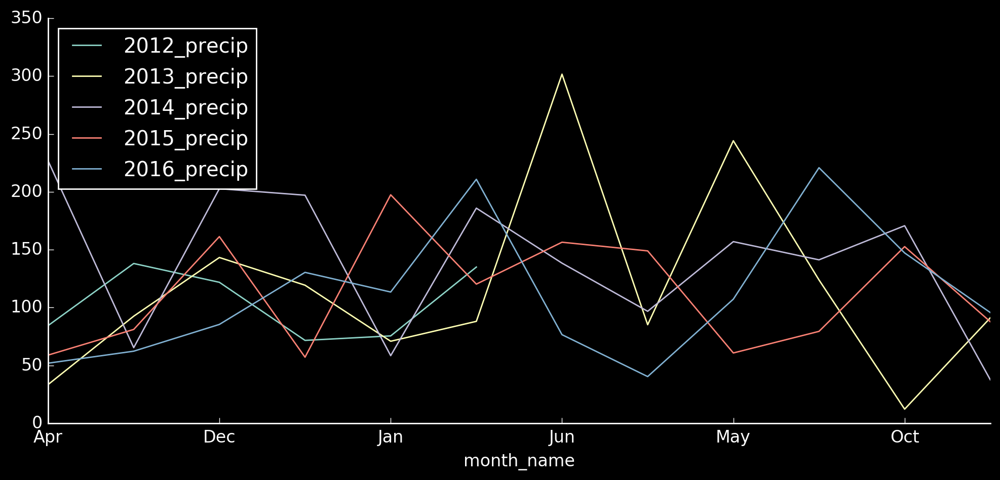

In [143]:
plt.style.use('dark_background')

fig, ax = plt.subplots(figsize=(12,5))

bike_2012.groupby(['month_name'])['2012_precip'].sum().plot()
bike_2013.groupby(['month_name'])['2013_precip'].sum().plot()
bike_2014.groupby(['month_name'])['2014_precip'].sum().plot()
bike_2015.groupby(['month_name'])['2015_precip'].sum().plot()
bike_2016.groupby(['month_name'])['2016_precip'].sum().plot()

plt.legend(loc='upper left')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

In [144]:
## setting up the borough dataframes for plotting
borough_mask_12 = bike_2012[bike_2012['BOROUGH'] != 0]
borough_mask_13 = bike_2013[bike_2013['BOROUGH'] != 0]
borough_mask_14 = bike_2014[bike_2014['BOROUGH'] != 0]
borough_mask_15 = bike_2015[bike_2015['BOROUGH'] != 0]
borough_mask_16 = bike_2016[bike_2016['BOROUGH'] != 0]

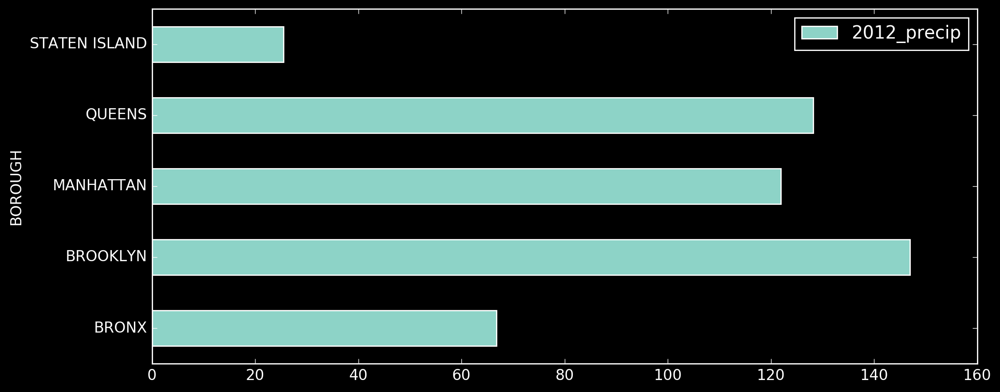

In [145]:
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
borough_mask_12.groupby(['BOROUGH'])['2012_precip'].sum().plot.barh(stacked=True)
ax.legend(loc='upper right')

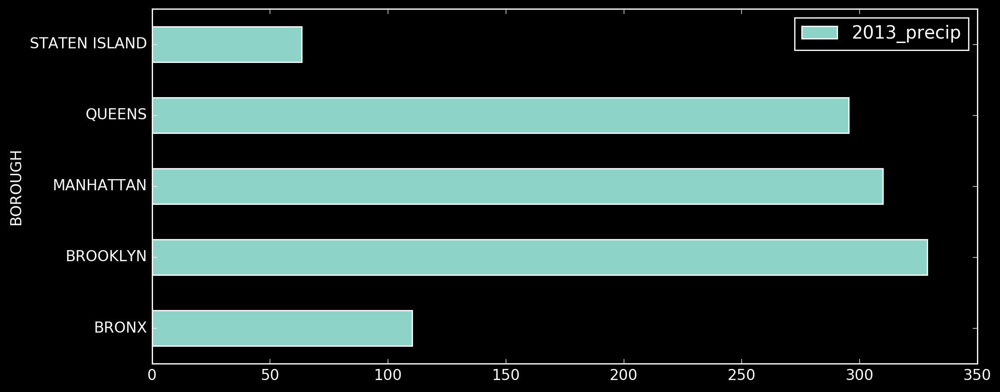

In [146]:
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
borough_mask_13.groupby(['BOROUGH'])['2013_precip'].sum().plot.barh(stacked=True)
ax.legend(loc='upper right')

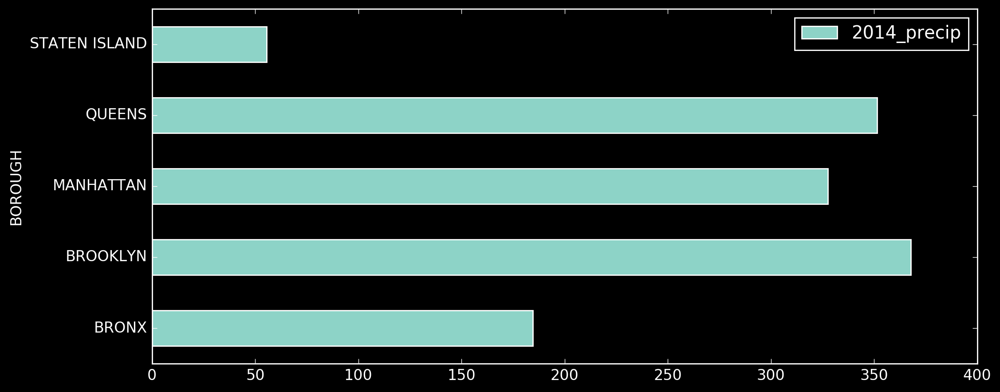

In [147]:
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
borough_mask_14.groupby(['BOROUGH'])['2014_precip'].sum().plot.barh(stacked=True)
ax.legend(loc='upper right')

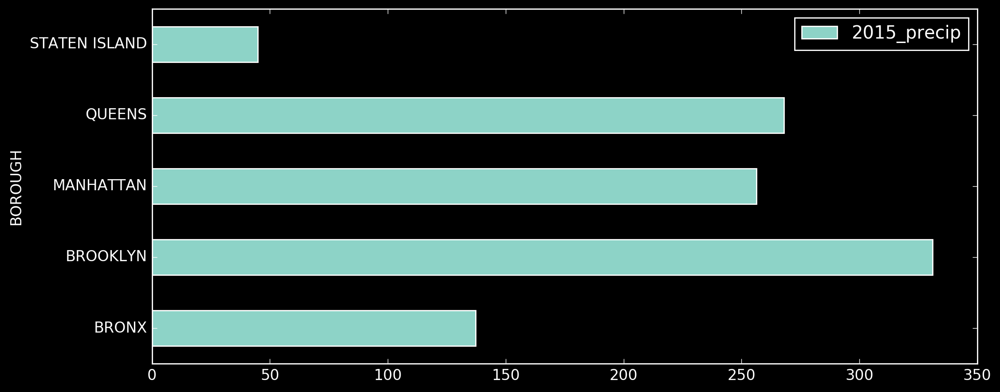

In [148]:
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
borough_mask_15.groupby(['BOROUGH'])['2015_precip'].sum().plot.barh(stacked=True)
ax.legend(loc='upper right')

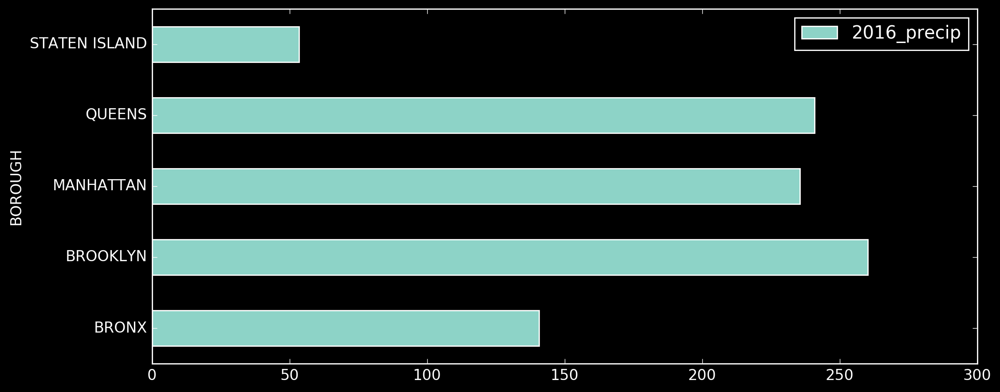

In [149]:
plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
borough_mask_16.groupby(['BOROUGH'])['2016_precip'].sum().plot.barh(stacked=True)
ax.legend(loc='upper right')

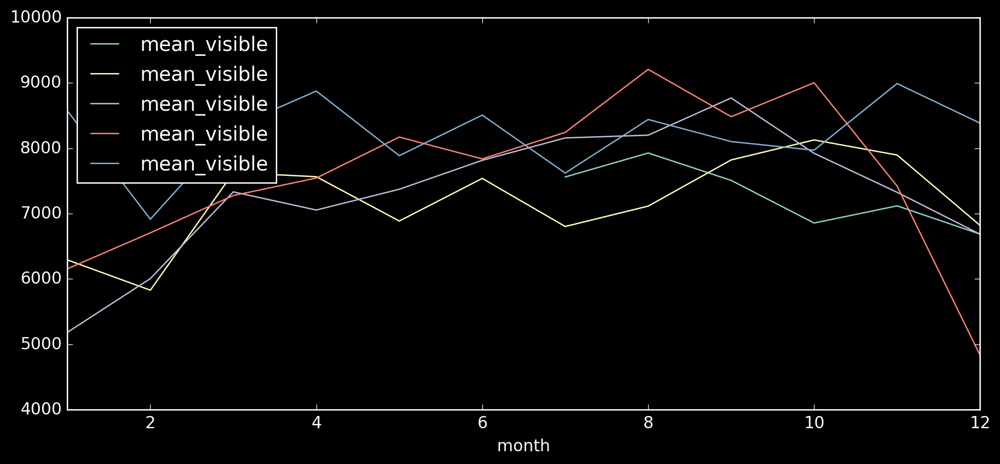

In [150]:
plt.style.use('dark_background')

fig, ax = plt.subplots(figsize=(12,5))

bike_2012.groupby(['month'])['mean_visible'].sum().plot()
bike_2013.groupby(['month'])['mean_visible'].sum().plot()
bike_2014.groupby(['month'])['mean_visible'].sum().plot()
bike_2015.groupby(['month'])['mean_visible'].sum().plot()
bike_2016.groupby(['month'])['mean_visible'].sum().plot()


ax.legend(loc='upper left')

In [151]:
NY_merged_samp_ = NY_merged_samp[NY_merged_samp['injuries'] != 0]

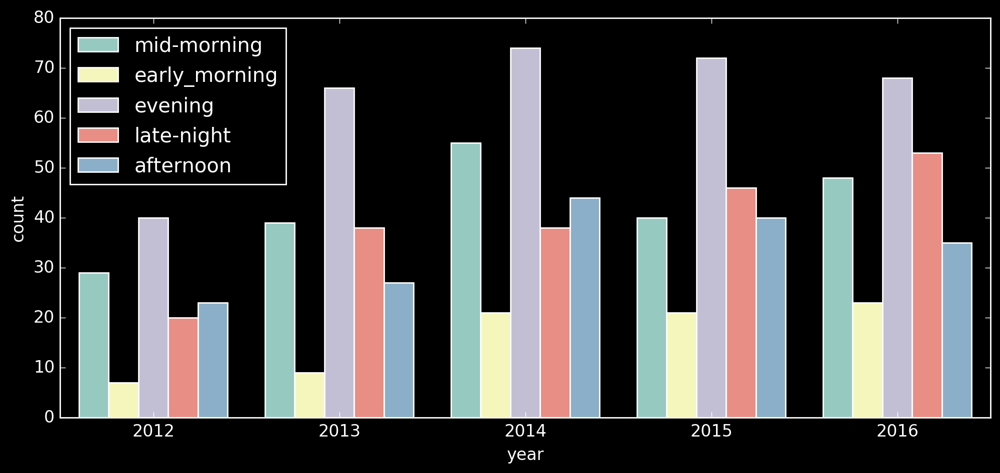

In [152]:
## plotting the number of cycling injuries per segment of day (between 1am and 6am = 'early morning',
## between 6am and 12pm = 'mid-morning', between 12pm and 3pm = 'afternoon', between 3pm and 7pm = 'evening' and
## between 7pm and midnight = 'late-night')

plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(12,5))
sns.countplot(x='year', data=NY_merged_samp_, hue='time_segment')
ax.legend(loc='upper left')

In [153]:
# ##standardizing my data so I can plot and visualize the trends...

# ##2012
# bike_2012_std = bike_2012[['NUMBER_OF_CYCLIST_INJURED', 'NUMBER_OF_CYCLIST_KILLED', 'PrecipitationIn']]
# bike_2012_std = (bike_2012_std - bike_2012_std.mean()) / bike_2012_std.std()
# bike_2012_std['MONTH'] = bike_2012['MONTH']

# ##2013
# bike_2013_std = bike_2013[['NUMBER_OF_CYCLIST_INJURED', 'NUMBER_OF_CYCLIST_KILLED', 'PrecipitationIn']]
# bike_2013_std = (bike_2013_std - bike_2013_std.mean()) / bike_2013_std.std()
# bike_2013_std['MONTH'] = bike_2013['MONTH']

# ##2014
# bike_2014_std = bike_2014[['NUMBER_OF_CYCLIST_INJURED', 'NUMBER_OF_CYCLIST_KILLED', 'PrecipitationIn']]
# bike_2014_std = (bike_2014_std - bike_2014_std.mean()) / bike_2014_std.std()
# bike_2014_std['MONTH'] = bike_2014['MONTH']

# ##2015
# bike_2015_std = bike_2015[['NUMBER_OF_CYCLIST_INJURED', 'NUMBER_OF_CYCLIST_KILLED', 'PrecipitationIn']]
# bike_2015_std = (bike_2015_std - bike_2015_std.mean()) / bike_2015_std.std()
# bike_2015_std['MONTH'] = bike_2015['MONTH']

# ##2016
# bike_2016_std = bike_2016[['NUMBER_OF_CYCLIST_INJURED', 'NUMBER_OF_CYCLIST_KILLED', 'PrecipitationIn']]
# bike_2016_std = (bike_2016_std - bike_2016_std.mean()) / bike_2016_std.std()
# bike_2016_std['MONTH'] = bike_2016['MONTH']

In [154]:
# NY_merged_samp.columns = NY_merged_samp.columns.str.replace(' ', '_')
# NY_merged_samp.fillna(0, inplace=True)
# NY_merged_samp['DATE'] = pd.to_datetime(NY_merged_samp['DATE'])
# NY_merged_samp = NY_merged_samp.sort_values(by='DATE')
# NY_merged_samp = NY_merged_samp[NY_merged_samp['DATE'] < '01/01/2017']

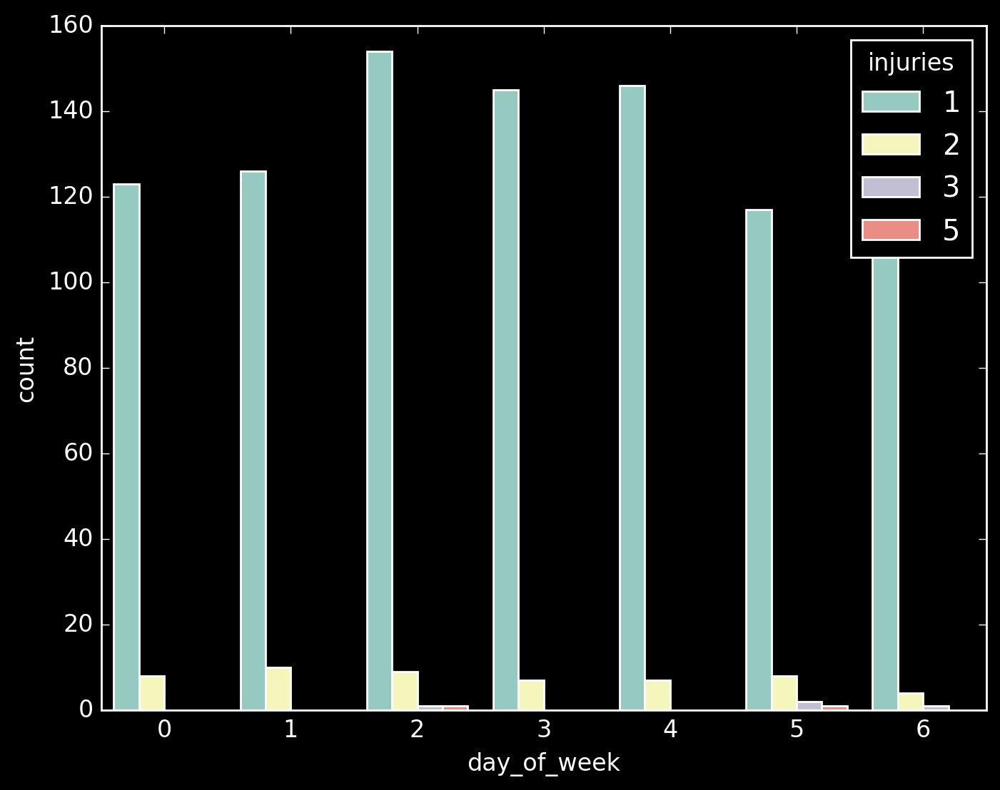

In [155]:
# NY_merged_samp.groupby(['year'])['injuries'].sum().plot(kind='bar')

sns.countplot(x='day_of_week', data=NY_merged_samp_, hue='injuries')

In [221]:
NY_merged_samp_.columns

Index([u'DATE', u'TIME', u'BOROUGH', u'ZIP_CODE', u'LATITUDE', u'LONGITUDE',
       u'LOCATION', u'ON_STREET_NAME', u'CROSS_STREET_NAME',
       u'OFF_STREET_NAME', u'NUMBER_OF_PERSONS_INJURED',
       u'NUMBER_OF_PERSONS_KILLED', u'NUMBER_OF_PEDESTRIANS_INJURED',
       u'NUMBER_OF_PEDESTRIANS_KILLED', u'injuries', u'deaths',
       u'NUMBER_OF_MOTORIST_INJURED', u'NUMBER_OF_MOTORIST_KILLED',
       u'vehicle_1', u'CONTRIBUTING_FACTOR_VEHICLE_2',
       u'CONTRIBUTING_FACTOR_VEHICLE_3', u'CONTRIBUTING_FACTOR_VEHICLE_4',
       u'CONTRIBUTING_FACTOR_VEHICLE_5', u'UNIQUE_KEY', u'VEHICLE_TYPE_CODE_1',
       u'VEHICLE_TYPE_CODE_2', u'VEHICLE_TYPE_CODE_3', u'VEHICLE_TYPE_CODE_4',
       u'VEHICLE_TYPE_CODE_5', u'max_temp', u'mean_temp', u'min_temp',
       u'max_dew', u'mean_dew', u'min_dew', u'max_humid', u'mean_humid',
       u'min_humid', u'_Max_Sea_Level_PressureIn',
       u'_Mean_Sea_Level_PressureIn', u'_Min_Sea_Level_PressureIn',
       u'max_visible', u'mean_visible', u'min_visib

In [288]:
NY_merged_samp_

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
67761,2012-11-01,12,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 Avenue,East 23 Street,0,...,0,11,1,4,3,5,mid-morning,3,2012,Nov
299889,2013-12-22,12,BROOKLYN,11226.0,40.650297,-73.966146,"(40.6502972, -73.9661462)",Caton Avenue,Marlborough Road,0,...,0,12,1,5,4,5,mid-morning,6,2013,Dec
769,2012-07-02,0,BROOKLYN,11218.0,40.636133,-73.972736,"(40.6361331, -73.9727361)",Ditmas Avenue,Ocean Parkway,0,...,0,7,1,5,4,4,early_morning,0,2012,Jul
650948,2015-08-29,18,BROOKLYN,11219.0,40.627693,-74.010501,"(40.6276929, -74.0105014)",69 Street,10 Avenue,0,...,0,8,1,5,4,4,evening,5,2015,Aug
218323,2013-08-01,21,BROOKLYN,11216.0,40.670008,-73.953271,"(40.6700084, -73.9532706)",Eastern Parkway,Rogers Avenue,0,...,1,8,1,5,5,5,late-night,3,2013,Aug
147611,2013-04-02,13,MANHATTAN,10009.0,40.729432,-73.978027,"(40.7294318, -73.978027)",East 14 Street,Avenue B,0,...,0,4,1,3,2,3,afternoon,1,2013,Apr
25538,2012-08-16,6,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 Avenue,East 23 Street,0,...,0,8,1,5,5,5,early_morning,3,2012,Aug
27607,2012-08-20,18,QUEENS,11101.0,40.746580,-73.943765,"(40.7465803, -73.943765)",Jackson Avenue,45 Avenue,0,...,0,8,1,5,4,5,evening,0,2012,Aug
839890,2016-07-04,21,BROOKLYN,11207.0,40.657683,-73.887784,"(40.6576831, -73.8877843)",Stanley Avenue,Vermont Street,0,...,1,7,1,5,5,4,late-night,0,2016,Jul
899750,2016-10-06,7,BROOKLYN,11214.0,40.605057,-73.998995,"(40.6050571, -73.9989952)",86 Street,Bay 23 Street,0,...,0,10,1,5,4,5,mid-morning,3,2016,Oct


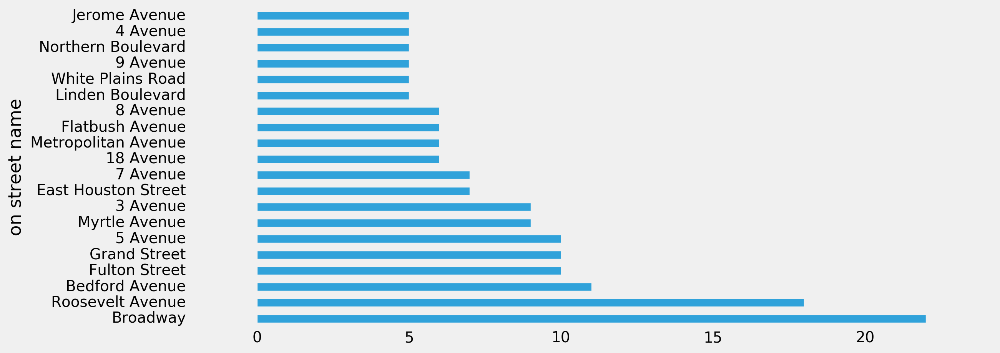

In [273]:
## proximity to the most dangerous areas of NYC. 
## proximity to the point where the accidents occured and also to the time of day in which it occured 
## need to figure out a baseline lat long

NY_merged_samp_ = NY_merged_samp_[NY_merged_samp_['BOROUGH'] != 0]
NY_merged_samp_ = NY_merged_samp_[NY_merged_samp_['ON_STREET_NAME'] != 0]
NY_merged_samp_['ON_STREET_NAME'] = NY_merged_samp_['ON_STREET_NAME'].map(lambda x: x.title())
NY_merged_samp_['CROSS_STREET_NAME'] = NY_merged_samp_['CROSS_STREET_NAME'].map(lambda x: x.title())


fig, ax = plt.subplots(figsize=(12,5))
plt.style.use('fivethirtyeight')

NY_merged_samp_.groupby(['ON_STREET_NAME'])['injuries'].sum().sort_values(ascending=False).head(20).plot(kind='barh')
plt.margins(x=0.1, y=0.1)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
ax.set_ylabel('on street name')
ax.grid(False)

In [410]:
## masking the data to show the most dangerous streets in NYC in terms of quantity of cycling accidents

broadway_mask = ((NY_merged_samp_['ON_STREET_NAME'] == 'Broadway') | 
                (NY_merged_samp_['ON_STREET_NAME'] == 'Roosevelt Avenue') |
                (NY_merged_samp_['ON_STREET_NAME'] == 'Bedford Avenue') |
                (NY_merged_samp_['ON_STREET_NAME'] == 'Fulton Street') |
                (NY_merged_samp_['ON_STREET_NAME'] == 'Grand Street') |
                (NY_merged_samp_['ON_STREET_NAME'] == '5 Avenue'))
deadly_streets_df = NY_merged_samp_[broadway_mask]
deadly_streets_df.shape

(79, 62)

In [441]:
map = folium.Map(location=[40.7347476, -73.9122528], zoom_start=11)
map.choropleth(geo_path=NYC_geo, data=NY_folium_df_group,
             columns=['Borough_folium', 'injuries'],
             key_on='properties.BoroName',
             fill_color='YlOrRd', fill_opacity=0.4, line_opacity=0.2,
             legend_name='Number of cycling accidents')

# stamen = folium.Map(location=[40.7347476, -73.9122528], tiles='cartodbpositron',
#                     zoom_start=11)

for desc, y, x in deadly_streets_df[['ON_STREET_NAME', 'LATITUDE', 'LONGITUDE']].head(200).values:
    folium.RegularPolygonMarker(location=[y, x], popup=desc, fill_color='#132b5e',number_of_sides=3, radius=5 ).add_to(map)
    
map

/anaconda/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [411]:
deadly_streets_df.groupby(['ON_STREET_NAME','CROSS_STREET_NAME'])['injuries'].sum()

ON_STREET_NAME    CROSS_STREET_NAME    
5 Avenue          3 Street                 1
                  34 Street                1
                  7 Street                 1
                  83 Street                1
                  Bergen Street            1
                  East 98 Street           1
                  St Marks Avenue          1
                  West 12 Street           1
                  West 32 Street           1
                  West 57 Street           1
Bedford Avenue    Atlantic Avenue          1
                  Avenue I                 1
                  Beverley Road            1
                  Clarendon Road           1
                  Clarkson Avenue          1
                  Linden Boulevard         1
                  Lorimer Street           1
                  Pacific Street           1
                  Sullivan Place           2
                  Winthrop Street          1
Broadway          51 Street                1
               

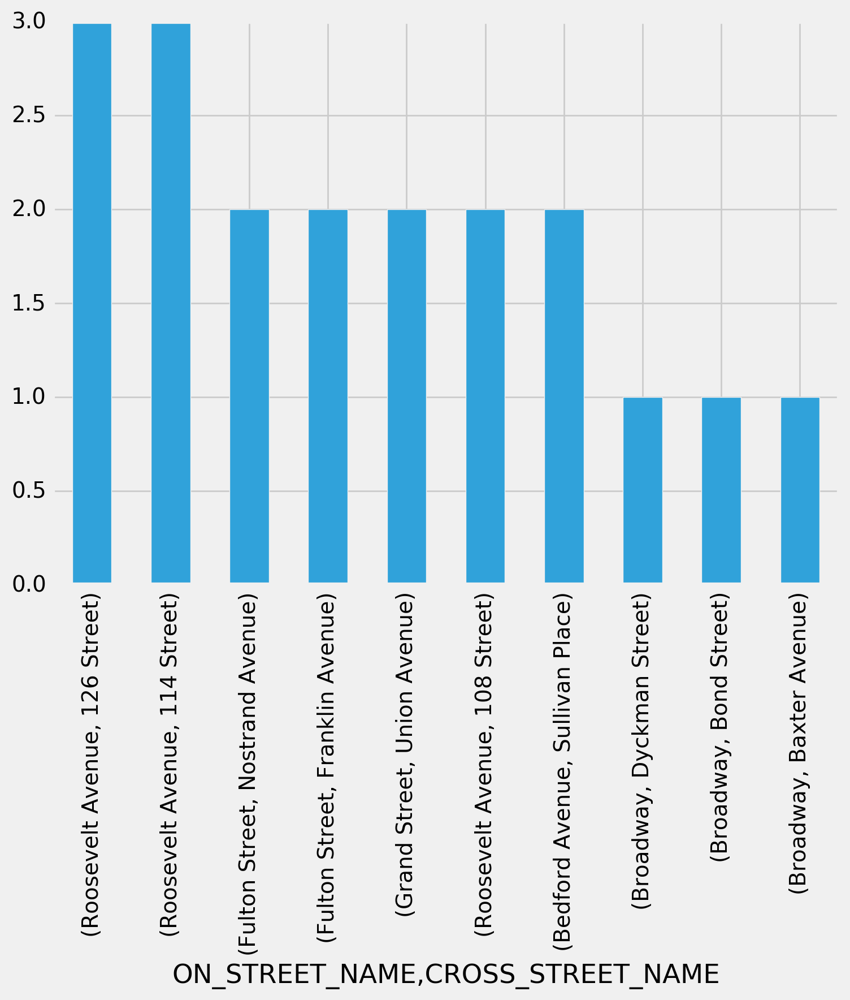

In [412]:
deadly_streets_df.groupby(['ON_STREET_NAME','CROSS_STREET_NAME'])['injuries'].sum().sort_values(ascending=False).head(10).plot(kind='bar')

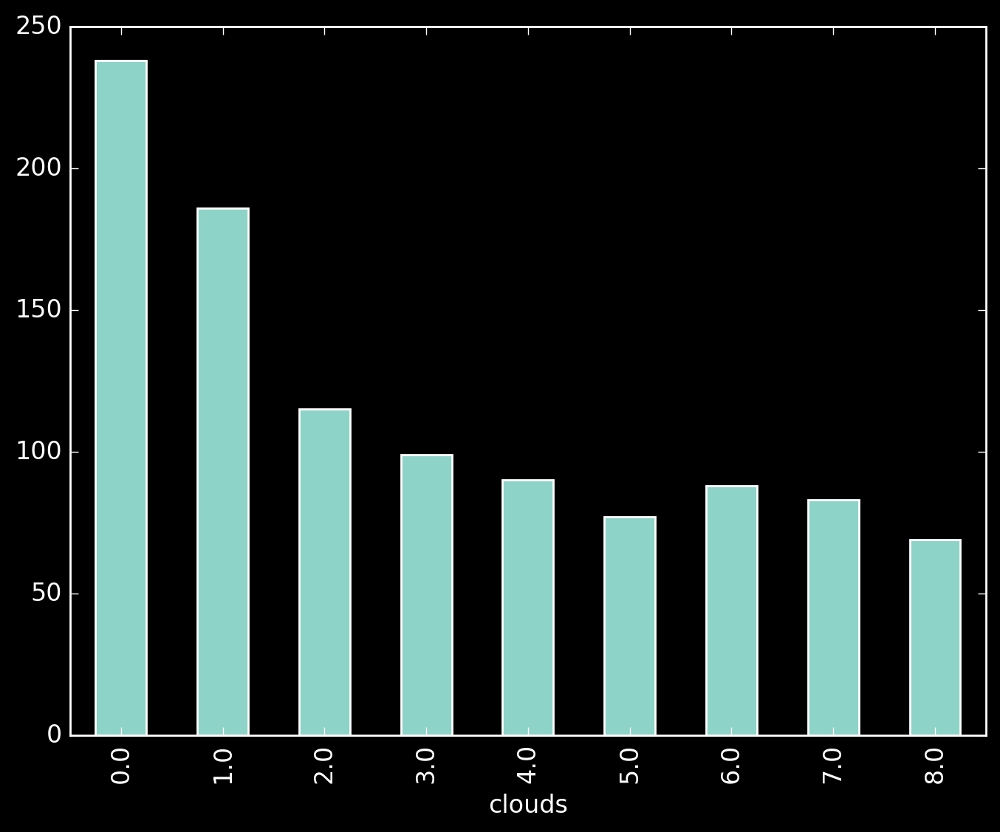

In [157]:
plt.style.use('dark_background')

NY_merged_samp.groupby(['clouds'])['injuries'].sum().plot(kind='bar')

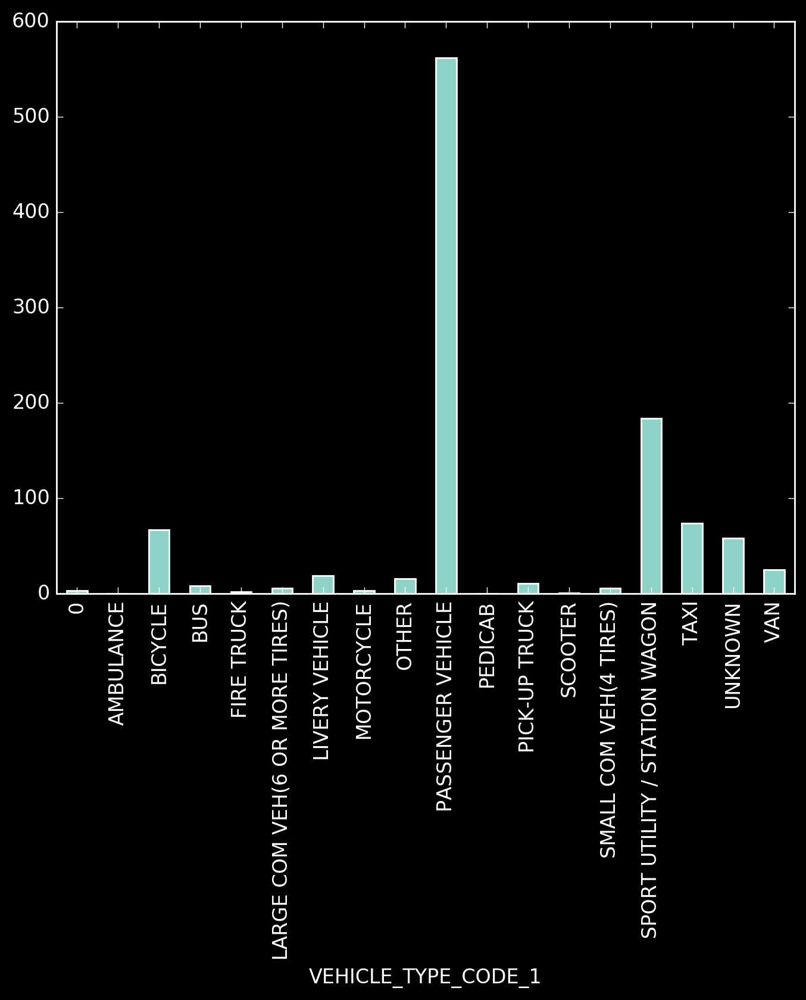

In [159]:
plt.style.use('dark_background')

NY_merged_samp.groupby(['VEHICLE_TYPE_CODE_1'])['injuries'].sum().plot(kind='bar')

In [160]:
NY_merged_samp.shape

(47739, 62)

In [ ]:
# consolidate into fewer categories:
# dew_cat
# humid_cat
# cloud cover
# wind speed

In [162]:
NY_merged_samp.columns

Index([u'DATE', u'TIME', u'BOROUGH', u'ZIP_CODE', u'LATITUDE', u'LONGITUDE',
       u'LOCATION', u'ON_STREET_NAME', u'CROSS_STREET_NAME',
       u'OFF_STREET_NAME', u'NUMBER_OF_PERSONS_INJURED',
       u'NUMBER_OF_PERSONS_KILLED', u'NUMBER_OF_PEDESTRIANS_INJURED',
       u'NUMBER_OF_PEDESTRIANS_KILLED', u'injuries', u'deaths',
       u'NUMBER_OF_MOTORIST_INJURED', u'NUMBER_OF_MOTORIST_KILLED',
       u'vehicle_1', u'CONTRIBUTING_FACTOR_VEHICLE_2',
       u'CONTRIBUTING_FACTOR_VEHICLE_3', u'CONTRIBUTING_FACTOR_VEHICLE_4',
       u'CONTRIBUTING_FACTOR_VEHICLE_5', u'UNIQUE_KEY', u'VEHICLE_TYPE_CODE_1',
       u'VEHICLE_TYPE_CODE_2', u'VEHICLE_TYPE_CODE_3', u'VEHICLE_TYPE_CODE_4',
       u'VEHICLE_TYPE_CODE_5', u'max_temp', u'mean_temp', u'min_temp',
       u'max_dew', u'mean_dew', u'min_dew', u'max_humid', u'mean_humid',
       u'min_humid', u'_Max_Sea_Level_PressureIn',
       u'_Mean_Sea_Level_PressureIn', u'_Min_Sea_Level_PressureIn',
       u'max_visible', u'mean_visible', u'min_visib

In [364]:
tmp.shape

(2489, 5)

In [192]:
tmp.corr()

,TIME,month,day_of_week,dew_cat,humid_cat,max_humid,_Mean_Sea_Level_PressureIn,max_temp,injuries
TIME,1.000000,0.000715,-0.023349,0.011630,-0.003480,-0.007146,-0.002735,0.015566,0.038537
month,0.000715,1.000000,-0.009825,0.297385,0.168829,0.133994,0.091713,0.240446,0.026126
day_of_week,-0.023349,-0.009825,1.000000,-0.019709,-0.025335,-0.011376,-0.035007,-0.006340,-0.001677
dew_cat,0.011630,0.297385,-0.019709,1.000000,0.464776,0.525045,0.044192,0.866788,0.056916
humid_cat,-0.003480,0.168829,-0.025335,0.464776,1.000000,0.844456,-0.046494,0.130869,0.011634
max_humid,-0.007146,0.133994,-0.011376,0.525045,0.844456,1.000000,-0.045367,0.235340,0.015341
_Mean_Sea_Level_PressureIn,-0.002735,0.091713,-0.035007,0.044192,-0.046494,-0.045367,1.000000,0.063209,0.003367
max_temp,0.015566,0.240446,-0.006340,0.866788,0.130869,0.235340,0.063209,1.000000,0.062413
injuries,0.038537,0.026126,-0.001677,0.056916,0.011634,0.015341,0.003367,0.062413,1.000000


In [180]:
tmp.shape

(26831, 10)

In [181]:
tmp.injuries.sum()

1045

In [ ]:
## Logistic Regression CV

In [ ]:
## overfit the anomolies and then cross validate on the overall

In [ ]:
# ## first I'm scaling my data



In [ ]:
tmp_scaled.shape

In [ ]:
# y = np.ravel(y)
y

In [199]:
tmp.columns

Index([u'TIME', u'month', u'BOROUGH', u'day_of_week', u'dew_cat', u'humid_cat',
       u'time_segment', u'max_humid', u'_Mean_Sea_Level_PressureIn',
       u'max_temp', u'injuries'],
      dtype='object')

In [354]:
tmp.head()

,month,BOROUGH,day_of_week,TIME,injuries
0,1,0,0,0,0
1,1,0,0,2,0
2,1,0,0,3,0
3,1,0,0,4,0
4,1,0,0,5,0


In [362]:
tmp = NY_merged_samp[['TIME','month','precip','BOROUGH','day_of_week','dew_cat','humid_cat',
                      'time_segment','injuries','max_humid','_Mean_Sea_Level_PressureIn',
                     'max_temp','vehicle_1']]

In [363]:
tmp = tmp.groupby(['month','BOROUGH','day_of_week',
                   'time_segment'])['injuries'].agg(np.sum)
tmp = tmp.reset_index()
tmp.head()

,month,BOROUGH,day_of_week,time_segment,injuries
0,1,0,0,afternoon,0
1,1,0,0,early_morning,0
2,1,0,0,evening,0
3,1,0,0,late-night,0
4,1,0,0,mid-morning,0


In [366]:
from sklearn.linear_model import LinearRegression

scores = []

formulas  =  {
    "injuries_predictions_1": "injuries ~ C(BOROUGH) + C(day_of_week) + C(month) + C(time_segment) -1",
    #"injuries_predictions_2": "injuries ~ day_of_week + max_humid",
    #"injuries_predictions_3": "injuries ~ month + day_of_week + max_humid + time_segment + max_temp -1"
}

for formula_name, formula in formulas.items():

    y, X     =  patsy.dmatrices(formula, data=tmp, return_type="dataframe")
    print X.columns
    y = y.values.ravel()
    #y = np.array([1 if x > 0 else 0 for x in y])
    print y.shape, X.shape
    #print 1. - np.mean(y)

    lm = LinearRegression()
    model = lm.fit(X, y)
    score = model.score(X, y)
    
    scores.append({
        "formula_name":  formula_name, 
        "formula":       formula,
        "R^2":           score
    })
    
pd.DataFrame(scores)

Index([u'C(BOROUGH)[0]', u'C(BOROUGH)[BRONX]', u'C(BOROUGH)[BROOKLYN]',
       u'C(BOROUGH)[MANHATTAN]', u'C(BOROUGH)[QUEENS]',
       u'C(BOROUGH)[STATEN ISLAND]', u'C(day_of_week)[T.1]',
       u'C(day_of_week)[T.2]', u'C(day_of_week)[T.3]', u'C(day_of_week)[T.4]',
       u'C(day_of_week)[T.5]', u'C(day_of_week)[T.6]', u'C(month)[T.2]',
       u'C(month)[T.3]', u'C(month)[T.4]', u'C(month)[T.5]', u'C(month)[T.6]',
       u'C(month)[T.7]', u'C(month)[T.8]', u'C(month)[T.9]', u'C(month)[T.10]',
       u'C(month)[T.11]', u'C(month)[T.12]',
       u'C(time_segment)[T.early_morning]', u'C(time_segment)[T.evening]',
       u'C(time_segment)[T.late-night]', u'C(time_segment)[T.mid-morning]'],
      dtype='object')
(2489,) (2489, 27)


,R^2,formula,formula_name
0,0.222311,injuries ~ C(BOROUGH) + C(day_of_week) + C(mon...,injuries_predictions_1


In [378]:
y, X = patsy.dmatrices(formula, data=tmp, return_type="dataframe")
y = y.values.ravel()
y = np.array([1 if y_ > 0 else 0 for y_ in y])
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

In [379]:
from sklearn.cross_validation import train_test_split
Xtr, Xte, ytr, yte = train_test_split(X, y, test_size=0.3)

In [380]:
#rfr = RandomForestRegressor(n_estimators=500, max_features=None, verbose=1)
#rfr.fit(Xtr, ytr)

rfc = RandomForestClassifier(n_estimators=500, verbose=1)
rfc.fit(Xtr, ytr)

[Parallel(n_jobs=1)]: Done  49 tasks       | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 199 tasks       | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks       | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    0.7s finished


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=500, n_jobs=1,
            oob_score=False, random_state=None, verbose=1,
            warm_start=False)

In [382]:
rfc.score(Xte, yte)

[Parallel(n_jobs=1)]: Done  49 tasks       | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 199 tasks       | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 449 tasks       | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    0.1s finished


0.73092369477911645

In [383]:
1. - np.mean(yte)

0.72289156626506024

In [213]:
print y.shape
print X.shape

(973, 1)
(973, 3)


In [214]:
from sklearn.linear_model import LinearRegression

lm = LinearRegression()
model = lm.fit(X, y)
predictions  =  model.predict(X)
score = model.score(X, y)
    
print "R^2 score:", score

R^2 score: 0.0032131947702


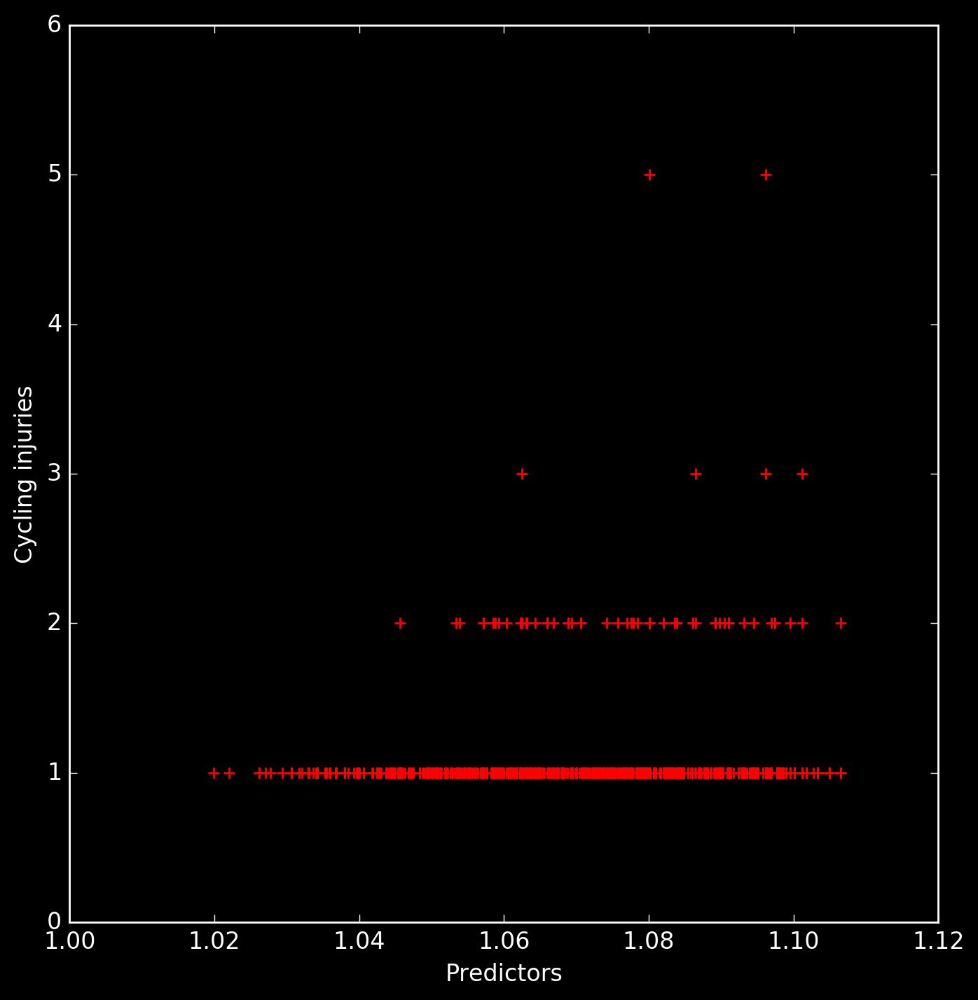

In [215]:
plt.figure(figsize=(8,8))
plt.scatter(predictions, y, s=30, c='r', marker='+', zorder=10)
plt.xlabel("Predictors")
plt.ylabel("Cycling injuries")
plt.show()

In [216]:
print "MSE:", mean_squared_error(y, predictions)

print 

print "COEFS:", zip(X.columns, model.coef_)

print 

print "SCORE/R^2:", model.score(X, y)

MSE: 0.101084373244

COEFS: [('Intercept', array([ 0.        ,  0.00311714,  0.00125393]))]

SCORE/R^2: 0.0032131947702


In [ ]:
residuals = y - predictions

fig = plt.figure(figsize=(7,7))
ax = fig.gca()

ax.scatter(y, residuals, color='forestgreen', s=70, label='true y - y hat', alpha=.50)

max_x = np.max(y)+10

ax.set_xlabel('y-hat', fontsize=16)
ax.set_ylabel('Residuals', fontsize=16)

plt.legend(loc='upper left')

plt.show()

In [343]:
NY_folium_df = NY_merged_samp[NY_merged_samp['BOROUGH'] != 0]
NY_folium_df.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)

In [344]:
# NY_folium_df.rename(columns={'BOROUGH':'BoroName'}, inplace=True)
NY_folium_df['Borough_folium'] = NY_folium_df['BoroughName'].map(lambda x: x.title())

/anaconda/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [345]:
NY_folium_df_group = NY_folium_df.groupby(['Borough_folium'])['injuries'].sum()

In [70]:
## setting up my segmented dataframes by season so that i can plot them across multiple foliums

NY_fall_13.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_fall_14.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_fall_15.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_fall_16.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_spring_13.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_spring_14.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_spring_15.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_spring_16.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_summer_13.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_summer_14.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_summer_15.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_summer_16.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_13a.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_13b.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_14a.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_14b.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_15a.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_15b.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_16a.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)
NY_winter_16b.rename(columns={'BOROUGH':'BoroughName'}, inplace=True)

In [346]:
import folium
from folium.utilities import split_six
import pandas as pd

NYC_geo = r'../Capstone/boroughs.geojson'
NYC_collisions = r'../../datasets/NY_merged_samp.pkl'

NYC_data = pd.read_pickle(NYC_collisions)

#Let Folium determine the scale
map = folium.Map(location=[40.6347476, -74.1122528], zoom_start=10)
map.choropleth(geo_path=NYC_geo, data=NY_folium_df_group,
             columns=['Borough_folium', 'injuries'],
             key_on='properties.BoroName',
             fill_color='YlOrRd', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Number of cycling accidents')
map.save('map_1.html')
map

/anaconda/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:16: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [65]:
NY_folium_df_2 = NY_folium_df.groupby(['Borough_folium'])['precip'].sum()

In [66]:
NY_folium_df_2

Borough_folium
Bronx             639.55
Brooklyn         1434.71
Manhattan        1251.32
Queens           1283.92
Staten Island     242.65
Name: precip, dtype: float64

In [74]:
import folium
from folium.utilities import split_six
import pandas as pd

NYC_geo = r'../Capstone/boroughs.geojson'
NYC_collisions = r'../../datasets/NY_merged_samp.pkl'

NYC_data = pd.read_pickle(NYC_collisions)

#Let Folium determine the scale
map = folium.Map(location=[40.6347476, -74.1122528], zoom_start=10)
map.choropleth(geo_path=NYC_geo, data=NY_folium_df_2,
             columns=['Borough_folium', 'injuries'],
             key_on='properties.BoroName',
             fill_color='YlGnBu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Amount of precipitation',
              reset=True)
map.save('map_1.html')
map

/anaconda/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:17: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [298]:
NY_merged_samp_.LOCATION

67761     (40.7388307, -73.9831481)
299889    (40.6502972, -73.9661462)
769       (40.6361331, -73.9727361)
650948    (40.6276929, -74.0105014)
218323    (40.6700084, -73.9532706)
147611     (40.7294318, -73.978027)
25538     (40.7388307, -73.9831481)
27607      (40.7465803, -73.943765)
839890    (40.6576831, -73.8877843)
899750    (40.6050571, -73.9989952)
191088    (40.6767074, -73.9771034)
244737    (40.6766464, -73.9164642)
382190    (40.7685207, -73.8286291)
157301    (40.7313217, -73.9886127)
450135    (40.8292339, -73.8755055)
656633    (40.8378662, -73.8635562)
167754    (40.7716958, -73.9591816)
114960    (40.7285697, -73.8580865)
563406    (40.7512976, -73.8893302)
78304     (40.7414951, -73.8750199)
193161     (40.728067, -73.9989537)
429788      (40.84271, -73.8856615)
620595    (40.7553365, -73.8432452)
440319    (40.8032165, -73.9525305)
255403    (40.6798365, -73.9343968)
634260    (40.8178464, -73.9418441)
95144      (40.6829709, -73.976665)
804282    (40.7250834, -73.9

In [312]:
NY_merged_samp_

,DATE,TIME,BOROUGH,ZIP_CODE,LATITUDE,LONGITUDE,LOCATION,ON_STREET_NAME,CROSS_STREET_NAME,OFF_STREET_NAME,...,precip_scale,month,injuries_binary,temp_cat,dew_cat,humid_cat,time_segment,day_of_week,year,month_name
67761,2012-11-01,12,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 Avenue,East 23 Street,0,...,0,11,1,4,3,5,mid-morning,3,2012,Nov
299889,2013-12-22,12,BROOKLYN,11226.0,40.650297,-73.966146,"(40.6502972, -73.9661462)",Caton Avenue,Marlborough Road,0,...,0,12,1,5,4,5,mid-morning,6,2013,Dec
769,2012-07-02,0,BROOKLYN,11218.0,40.636133,-73.972736,"(40.6361331, -73.9727361)",Ditmas Avenue,Ocean Parkway,0,...,0,7,1,5,4,4,early_morning,0,2012,Jul
650948,2015-08-29,18,BROOKLYN,11219.0,40.627693,-74.010501,"(40.6276929, -74.0105014)",69 Street,10 Avenue,0,...,0,8,1,5,4,4,evening,5,2015,Aug
218323,2013-08-01,21,BROOKLYN,11216.0,40.670008,-73.953271,"(40.6700084, -73.9532706)",Eastern Parkway,Rogers Avenue,0,...,1,8,1,5,5,5,late-night,3,2013,Aug
147611,2013-04-02,13,MANHATTAN,10009.0,40.729432,-73.978027,"(40.7294318, -73.978027)",East 14 Street,Avenue B,0,...,0,4,1,3,2,3,afternoon,1,2013,Apr
25538,2012-08-16,6,MANHATTAN,10010.0,40.738831,-73.983148,"(40.7388307, -73.9831481)",3 Avenue,East 23 Street,0,...,0,8,1,5,5,5,early_morning,3,2012,Aug
27607,2012-08-20,18,QUEENS,11101.0,40.746580,-73.943765,"(40.7465803, -73.943765)",Jackson Avenue,45 Avenue,0,...,0,8,1,5,4,5,evening,0,2012,Aug
839890,2016-07-04,21,BROOKLYN,11207.0,40.657683,-73.887784,"(40.6576831, -73.8877843)",Stanley Avenue,Vermont Street,0,...,1,7,1,5,5,4,late-night,0,2016,Jul
899750,2016-10-06,7,BROOKLYN,11214.0,40.605057,-73.998995,"(40.6050571, -73.9989952)",86 Street,Bay 23 Street,0,...,0,10,1,5,4,5,mid-morning,3,2016,Oct


In [329]:
import folium
from folium.utilities import split_six
import pandas as pd
from folium.plugins import MarkerCluster

In [348]:
NYC_data = pd.read_pickle(NYC_collisions)
NYC_geo = r'../Capstone/boroughs.geojson'
NYC_collisions = r'../../datasets/NY_merged_samp.pkl'

NY_COORDINATES = (40.6347476, -74.1122528)
# for speed purposes
locations = []

MAX_RECORDS = 1000
# create empty map zoomed in on San Francisco
map = folium.Map(location=NY_COORDINATES, zoom_start=10, tiles='cartodbpositron')

# add a marker for every record in the filtered data, use a clustered view

b = map.choropleth(geo_path=NYC_geo, data=NY_folium_df_group,
             columns=['Borough_folium', 'injuries'],
             key_on='properties.BoroName',
             fill_color='YlOrRd', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Number of cycling accidents')

h = folium.FeatureGroup(name='bike')
for each in NY_merged_samp_[0:MAX_RECORDS].iterrows():
    location = ([each[1]['LATITUDE'],each[1]['LONGITUDE']])
    locations.append(location)

h.add_children(MarkerCluster(locations=locations))#, popups=popups))

map.add_children(h)
#display(map)


/anaconda/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:15: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [318]:
# map_1 = folium.Map(location=[40.6347476, -74.1122528],
#                    tiles = 'Stamen Terrain',
#                    zoom_start=10)


# folium.Marker((40.6347476, -74.1122528) ,icon=folium.Icon(icon='cloud')).add_to(map_1)
# folium.Marker((40.8063462, -73.9331715) ,icon=folium.Icon(icon='cloud')).add_to(map_1)
# # folium.Marker((40.7063462, -73.5331715) ,).add_to(map_1)
# map_1.circle_marker(((40.7063462, -73.5331715)), radius=200)

# map_1


# Also: pip install folium
import folium
from bs4 import BeautifulSoup
import urllib
import folium
from folium import plugins

stamen = folium.Map(location=[40.6347476, -74.1122528], tiles='Stamen Toner',
                    zoom_start=10)

for desc, y, x in NY_merged_samp_[['ON_STREET_NAME', 'LATITUDE', 'LONGITUDE']].head(200).values:
    folium.Marker(location=[y, x], popup=desc).add_to(stamen)
    
# stamen.add_children(plugins.HeatMap(zip('LATITUDE', 'LONGITUDE'), radius = 10))
map_ = stamen

In [ ]:
## think of a route to take, pass through google maps, and match against the dataset of street names